### Project Overview: Exploring and Analyzing Airbnb Listings Data in France

The Airbnb dataset provides listing data for a specific period, spanning from March 13, 2023, to March 27, 2024, with the last web scrape conducted on March 29, 2023. The dataset consists of six files, each containing valuable information related to listings in France. These files contain a diverse range of features, including property information, neighborhood details, pricing, availability, host characteristics, and guest reviews. The initial uncleaned dataset was processed to address missing data, multicollinearity, and outliers using appropriate techniques. Regression models were then applied to extract valuable insights. 

To handle missing values efficiently within the given time constraints, statistical imputation was employed, utilizing median imputation for improved representation of skewed data. Multicollinearity was assessed using VIF, and variables with VIF above 10 were removed. For data preparation, Z-score scaling was applied, and categorical variables were converted to numeric using dummy variables. Regression models, including Linear Regression and Random Forest Regression, were employed to predict prices accurately.

By leveraging the Airbnb dataset for France and employing data cleaning, data engineering, and EDA techniques, this project aimed to contribute to a better understanding of the French rental market. The analysis focused on identifying patterns, trends, and pricing strategies, thereby offering valuable insights for businesses operating in the travel industry. due to time limitations, the analysis may not have explored all aspects of the dataset in depth.Some actionable insights can be derived as follows:

1.	Pricing Strategy Optimization:
- Develop a pricing tool that provides hosts with optimal price recommendations by considering market trends, competition, and customer preferences. This tool takes into account high-demand neighborhoods, property/room type, number of accommodations, bedrooms, baths, and peak booking periods. Utilize supervised machine learning models like linear regression and random forest regression, and employ GridSearch for fine-tuning the models to accurately predict listing prices based on a comprehensive set of features. This tool enables hosts to maximize their revenue while remaining competitive in the market.

2.	Host Performance Improvement:
- Create a host performance dashboard that highlights key metrics like response rate, acceptance rate, and response times to identify factors contributing to higher host performance. This tool empowers hosts to assess their performance, gain valuable insights, and make informed decisions to enhance their hosting experience.

 3.	Customer Preference Analysis:
 - Explore the relationship between customer reviews and various review scores (e.g., accuracy, cleanliness, communication) to identify the key factors influencing customer satisfaction. Build a sentiment analysis model to analyze guest reviews and extract valuable insights about their preferences, concerns, and satisfaction levels.
 
 4.	Demand Forecasting:
- Use time-series analysis techniques to forecast the demand for Airbnb listings in specific regions or neighborhoods. Develop a demand forecasting tool that helps hosts optimize their pricing and availability based on predicted demand patterns. This tool can assist hosts in maximizing occupancy rates and revenue.

5.	Market Competition Analysis:
- Analyze the competitive landscape by examining the number of listings and availability in different neighborhoods and property types. Build a market competition dashboard that provides insights on market capacity, pricing trends, and demand-supply gaps. This tool can help hosts identify areas with less competition and potential business opportunities

6.	Neighborhood Recommendation Engine:
- Utilize clustering algorithms (e.g., K-means) to group neighborhoods based on similarities in listing attributes, amenities, and pricing. Develop a neighborhood recommendation engine that suggests suitable neighborhoods for hosts based on their property type, target market, and desired rental income. This tool can assist hosts in identifying the most promising areas to invest in.

7.	Fraud Detection:
- Build a fraud detection system that flags listings with unusual pricing patterns, inconsistent information, or suspicious host behavior. This tool can help Airbnb and its users maintain a trustworthy platform.

- Note: Given the time constraints, the data analysis and model implementation were carried out at an initial stage without digging into a comprehensive exploration. The analysis and modeling efforts were limited, and a deeper investigation into the dataset was not conducted due to time limitations.

#### 1. Loading Libraries:

In [1]:
# Loading Libraries:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


%matplotlib inline
import numpy as np
import pandas as pd
import json
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import datetime as dt
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objects as go
import plotly.subplots as sp


import geopandas as gpd
from shapely.geometry import Point
from branca.colormap import LinearColormap
import ast
import folium
from folium.plugins import HeatMap
from folium.plugins import FastMarkerCluster


import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import re
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from wordcloud import WordCloud
from scipy import sparse

from statsmodels.stats.outliers_influence import variance_inflation_factor 
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score
from statsmodels.tools.eval_measures import mse,rmse
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV



#### 2. Importing DataSet:
##### 2.1. Listing DataSet:

In [2]:
# Loading the Dataset:
df1 = pd.read_csv(r'C:\Users\paric\BoeingDataChallenge\listing.csv')

In [3]:
# Look at the Dataset
df1.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,5396,https://www.airbnb.com/rooms/5396,20230313171257,2023-03-14,city scrape,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",https://a0.muscache.com/pictures/52413/f9bf76f...,7903,...,4.83,4.95,4.54,7510402838018,f,1,1,0,0,1.99
1,7397,https://www.airbnb.com/rooms/7397,20230313171257,2023-03-29,city scrape,MARAIS - 2ROOMS APT - 2/4 PEOPLE,"VERY CONVENIENT, WITH THE BEST LOCATION !<br /...",NaN,https://a0.muscache.com/pictures/67928287/330b...,2626,...,4.88,4.93,4.73,7510400829623,f,2,2,0,0,2.26
2,7964,https://www.airbnb.com/rooms/7964,20230313171257,2023-03-14,city scrape,Sunny apartment with balcony,"We are renting our a spacious, sunny fully fur...",NaN,https://a0.muscache.com/pictures/miso/Hosting-...,22155,...,5.00,5.00,5.00,7510903576564,f,1,1,0,0,0.04
3,9359,https://www.airbnb.com/rooms/9359,20230313171257,2023-03-14,city scrape,"Cozy, Central Paris: WALK or VELIB EVERYWHERE !",Location! Location! Location! Just bring your ...,NaN,https://a0.muscache.com/pictures/c2965945-061f...,28422,...,NaN,NaN,NaN,"Available with a mobility lease only (""bail mo...",f,1,1,0,0,NaN
4,9952,https://www.airbnb.com/rooms/9952,20230313171257,2023-03-14,city scrape,Paris petit coin douillet,"Je suis une dame retraitée, qui propose un agr...","Vibrant neighborhood, full of bars, cafés, fre...",https://a0.muscache.com/pictures/ae822d16-74d2...,33534,...,4.84,4.88,4.91,7511101582862,f,1,1,0,0,0.35


In [4]:
# Look at the Dataset Shape:
df1.shape

(56726, 75)

In [5]:
# Look at the Data Type:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56726 entries, 0 to 56725
Data columns (total 75 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            56726 non-null  int64  
 1   listing_url                                   56726 non-null  object 
 2   scrape_id                                     56726 non-null  int64  
 3   last_scraped                                  56726 non-null  object 
 4   source                                        56726 non-null  object 
 5   name                                          56689 non-null  object 
 6   description                                   56161 non-null  object 
 7   neighborhood_overview                         32447 non-null  object 
 8   picture_url                                   56725 non-null  object 
 9   host_id                                       56726 non-null 

In [6]:
# Look at the number of unique value & unique value of each column:
for col in df1:
    print('Number of unique values in column {} are {} : {}'.format(col, df1[col].nunique(),df1[col].unique()))

Number of unique values in column id are 56726 : [              5396               7397               7964 ...
 843268818718844445 843270207995447181 843272911371318203]
Number of unique values in column listing_url are 56726 : ['https://www.airbnb.com/rooms/5396' 'https://www.airbnb.com/rooms/7397'
 'https://www.airbnb.com/rooms/7964' ...
 'https://www.airbnb.com/rooms/843268818718844445'
 'https://www.airbnb.com/rooms/843270207995447181'
 'https://www.airbnb.com/rooms/843272911371318203']
Number of unique values in column scrape_id are 1 : [20230313171257]
Number of unique values in column last_scraped are 4 : ['2023-03-14' '2023-03-29' '2023-03-15' '2023-03-13']
Number of unique values in column source are 2 : ['city scrape' 'previous scrape']
Number of unique values in column name are 54403 : ['Explore the heart of old Paris' 'MARAIS - 2ROOMS APT - 2/4 PEOPLE'
 'Sunny apartment with balcony' ... 'Chic flat Place des Vosges'
 'Bel Appartement Studio Moderne Mezzanine - 4P'
 'La peti

Number of unique values in column host_id are 42490 : [     7903      2626     22155 ... 133340498   2604436   7584057]
Number of unique values in column host_url are 42490 : ['https://www.airbnb.com/users/show/7903'
 'https://www.airbnb.com/users/show/2626'
 'https://www.airbnb.com/users/show/22155' ...
 'https://www.airbnb.com/users/show/133340498'
 'https://www.airbnb.com/users/show/2604436'
 'https://www.airbnb.com/users/show/7584057']
Number of unique values in column host_name are 8709 : ['Borzou' 'Franck' 'Anaïs' ... 'Lanlan' 'Gaubert' 'Elle']
Number of unique values in column host_since are 4508 : ['2009-02-14' '2008-08-30' '2009-06-18' ... '2023-03-10' '2023-03-12'
 '2021-08-29']
Number of unique values in column host_location are 1633 : ['İstanbul, Turkey' 'Paris, France' 'New York, NY' ...
 'Villers-Bocage, France' 'Hollywood, FL' 'Scotland, United Kingdom']
Number of unique values in column host_about are 17819 : ["The flat is owned by journalists who spend a lot of time tr

Number of unique values in column neighbourhood_cleansed are 20 : ['Hôtel-de-Ville' 'Opéra' 'Louvre' 'Popincourt' 'Buttes-Montmartre'
 'Luxembourg' 'Gobelins' 'Entrepôt' 'Batignolles-Monceau' 'Temple'
 'Buttes-Chaumont' 'Bourse' 'Ménilmontant' 'Observatoire' 'Panthéon'
 'Vaugirard' 'Élysée' 'Reuilly' 'Passy' 'Palais-Bourbon']
Number of unique values in column neighbourhood_group_cleansed are 0 : [nan]
Number of unique values in column latitude are 15581 : [48.85247    48.85909    48.87417    ... 48.85344684 48.86972936
 48.8709002 ]
Number of unique values in column longitude are 21181 : [2.35835    2.35315    2.34245    ... 2.36411977 2.34974298 2.3993274 ]
Number of unique values in column property_type are 65 : ['Entire rental unit' 'Entire loft' 'Private room in rental unit'
 'Entire condo' 'Private room in guest suite' 'Entire home' 'Entire place'
 'Private room in townhouse' 'Private room in bed and breakfast'
 'Entire guesthouse' 'Private room in guesthouse' 'Entire townhouse'
 

In [7]:
# Look at the Missing Values:
sum_null_columns= df1.isnull().sum().sort_values(ascending=False)
percent_null_counts = round(df1.isnull().sum()*100/df1.isnull().count(),2).sort_values(ascending=False)
missing_data_columns = pd.concat([sum_null_columns, percent_null_counts], axis=1, keys=['sum_null_columns','percent_null_columns'])
missing_data_columns[missing_data_columns>0].sort_values(by='percent_null_columns', ascending=False)[:45]

,sum_null_columns,percent_null_columns
neighbourhood_group_cleansed,56726.0,100.00
calendar_updated,56726.0,100.00
bathrooms,56726.0,100.00
host_about,29860.0,52.64
host_response_rate,25577.0,45.09
host_response_time,25577.0,45.09
neighbourhood,24279.0,42.80
neighborhood_overview,24279.0,42.80
host_neighbourhood,23831.0,42.01
host_acceptance_rate,21316.0,37.58


In [8]:
# Drop Null and Useless Columns:
df = df1.drop(['neighbourhood_group_cleansed','calendar_updated','bathrooms','listing_url','scrape_id','host_thumbnail_url','host_picture_url','host_has_profile_pic','picture_url','host_url','source','license'], axis=1)

In [9]:
# Rename Column name:
df = df.rename(columns={'id': 'listing_id'})

##### 2.2. Neighbourhood DataSet:

In [10]:
# Loading Dataset:
df2 = pd.read_csv(r'C:\Users\paric\BoeingDataChallenge\neighbourhood.csv')
df2.head()

,neighbourhood_group,neighbourhood
0,NaN,Batignolles-Monceau
1,NaN,Bourse
2,NaN,Buttes-Chaumont
3,NaN,Buttes-Montmartre
4,NaN,Élysée


In [11]:
# Drop Useless Column:
df2 = df2.drop('neighbourhood_group',axis=1)
# Rename Column Name:
df2 = df2.rename(columns={'neighbourhood':'neighbourhood_cleansed'})

In [12]:
# Merging Dataset
df = pd.merge(df2,df, on = 'neighbourhood_cleansed', how = "left")
df.head()

,neighbourhood_cleansed,listing_id,last_scraped,name,description,neighborhood_overview,host_id,host_name,host_since,host_location,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,Batignolles-Monceau,248869,2023-03-14,Loft Baron,Le Loft baron est un appartement claire et cal...,NaN,1303882,Cyril & Aurélie,2011-10-17,"Paris, France",...,4.92,4.92,4.67,4.52,f,1,1,0,0,0.82
1,Batignolles-Monceau,111270,2023-03-14,charming flat near Champs-Elysées,It's a very Parisian and charming Pop Art flat...,The apartment is located 6mn walk from Arc-de-...,570314,François & Pascale,2011-05-09,"Paris, France",...,4.94,4.94,4.85,4.79,f,2,1,1,0,0.38
2,Batignolles-Monceau,24260,2023-03-14,Lovely place near Champs Elysees,This fully furnished 1 bedroom is located righ...,"The neighborhood is chic, safe, with lots of s...",98012,Emmanuel,2010-03-23,"Paris, France",...,4.91,4.91,4.82,4.64,f,2,2,0,0,0.19
3,Batignolles-Monceau,301233,2023-03-14,ExeptCharm Balcony View Sun AirCond,"""At home in Paris"", it's possible!<br />Apartm...",Village atmosphere secure<br />All shops<br />...,1551963,Danièle,2011-12-31,"Paris, France",...,4.93,5.00,4.85,4.63,f,1,1,0,0,0.21
4,Batignolles-Monceau,40911,2023-03-14,The White & Cosy Flat,"<b>The space</b><br />Hello, <br />My flat is...",NaN,177212,David,2010-07-22,"Paris, France",...,5.00,4.75,4.33,4.44,f,1,1,0,0,0.06


In [13]:
# Look at the Shape:
df.shape

(56726, 63)

##### 2.3. Geojson DataSet:

In [14]:
# Loading Dataset:
df3 = gpd.read_file(r'C:\Users\paric\BoeingDataChallenge\neighbourhoods.geojson')
df3.head()

,neighbourhood,neighbourhood_group,geometry
0,Batignolles-Monceau,NaN,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8..."
1,Palais-Bourbon,NaN,"MULTIPOLYGON (((2.32090 48.86306, 2.32094 48.8..."
2,Buttes-Chaumont,NaN,"MULTIPOLYGON (((2.38943 48.90122, 2.39014 48.9..."
3,Opéra,NaN,"MULTIPOLYGON (((2.33978 48.88203, 2.33982 48.8..."
4,Entrepôt,NaN,"MULTIPOLYGON (((2.36469 48.88437, 2.36485 48.8..."


In [15]:
# Drop Useless Column:
df3 = df3.drop('neighbourhood_group',axis=1)
# Rename Column Name:
df3 = df3.rename(columns={'neighbourhood':'neighbourhood_cleansed'})

In [16]:
# Merge Two Dataset:
df = pd.merge(df3,df, on = 'neighbourhood_cleansed', how = "left")
df.head()

,neighbourhood_cleansed,geometry,listing_id,last_scraped,name,description,neighborhood_overview,host_id,host_name,host_since,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,Batignolles-Monceau,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8...",248869,2023-03-14,Loft Baron,Le Loft baron est un appartement claire et cal...,NaN,1303882,Cyril & Aurélie,2011-10-17,...,4.92,4.92,4.67,4.52,f,1,1,0,0,0.82
1,Batignolles-Monceau,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8...",111270,2023-03-14,charming flat near Champs-Elysées,It's a very Parisian and charming Pop Art flat...,The apartment is located 6mn walk from Arc-de-...,570314,François & Pascale,2011-05-09,...,4.94,4.94,4.85,4.79,f,2,1,1,0,0.38
2,Batignolles-Monceau,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8...",24260,2023-03-14,Lovely place near Champs Elysees,This fully furnished 1 bedroom is located righ...,"The neighborhood is chic, safe, with lots of s...",98012,Emmanuel,2010-03-23,...,4.91,4.91,4.82,4.64,f,2,2,0,0,0.19
3,Batignolles-Monceau,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8...",301233,2023-03-14,ExeptCharm Balcony View Sun AirCond,"""At home in Paris"", it's possible!<br />Apartm...",Village atmosphere secure<br />All shops<br />...,1551963,Danièle,2011-12-31,...,4.93,5.00,4.85,4.63,f,1,1,0,0,0.21
4,Batignolles-Monceau,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8...",40911,2023-03-14,The White & Cosy Flat,"<b>The space</b><br />Hello, <br />My flat is...",NaN,177212,David,2010-07-22,...,5.00,4.75,4.33,4.44,f,1,1,0,0,0.06


In [17]:
# Look at the Shape:
df.shape

(56726, 64)

##### 2.4. Reviews DataSet:

In [18]:
# Loading Dataset:
df4 = pd.read_csv(r'C:\Users\paric\BoeingDataChallenge\reviews.csv')
df4.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,5396,4824,2009-06-30,19995,Sarah,Perfect location!! Nasrine was a delight and m...
1,5396,4968,2009-07-03,20117,Chris,This is a nice place in a great location in Pa...
2,5396,5240,2009-07-08,22190,Annelaure,"Nice studio, very clean, very quiet, in a grea..."
3,5396,9619,2009-09-10,11947,Jean,"Superb location, great studio. \r<br/>A slice ..."
4,5396,18970,2009-12-02,40625,Bette,"Perfect place to be in Paris, walking home eve..."


In [19]:
# Drop Useless Column:
df4 = df4[['listing_id','reviewer_id','comments']]
df4.shape

(1406845, 3)

In [20]:
# Merging Dataset:
df = pd.merge(df4, df, on = "listing_id", how = "left")

In [21]:
# Look at the Dataset:
df.head()

,listing_id,reviewer_id,comments,neighbourhood_cleansed,geometry,last_scraped,name,description,neighborhood_overview,host_id,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,5396,19995,Perfect location!! Nasrine was a delight and m...,Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
1,5396,20117,This is a nice place in a great location in Pa...,Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
2,5396,22190,"Nice studio, very clean, very quiet, in a grea...",Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
3,5396,11947,"Superb location, great studio. \r<br/>A slice ...",Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
4,5396,40625,"Perfect place to be in Paris, walking home eve...",Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99


#### 3. Data Preprosseing : 

##### 3.1. Cleaning DataSet: 

In [22]:
# Look at the Final DataSet:
df.head()

,listing_id,reviewer_id,comments,neighbourhood_cleansed,geometry,last_scraped,name,description,neighborhood_overview,host_id,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,5396,19995,Perfect location!! Nasrine was a delight and m...,Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
1,5396,20117,This is a nice place in a great location in Pa...,Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
2,5396,22190,"Nice studio, very clean, very quiet, in a grea...",Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
3,5396,11947,"Superb location, great studio. \r<br/>A slice ...",Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99
4,5396,40625,"Perfect place to be in Paris, walking home eve...",Hôtel-de-Ville,"MULTIPOLYGON (((2.36851 48.85573, 2.36900 48.8...",2023-03-14,Explore the heart of old Paris,"Cozy, well-appointed and graciously designed s...","You are within walking distance to the Louvre,...",7903,...,4.79,4.83,4.95,4.54,f,1,1,0,0,1.99


In [23]:
# Look at the DataSet Type:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1406845 entries, 0 to 1406844
Data columns (total 66 columns):
 #   Column                                        Non-Null Count    Dtype   
---  ------                                        --------------    -----   
 0   listing_id                                    1406845 non-null  int64   
 1   reviewer_id                                   1406845 non-null  int64   
 2   comments                                      1406761 non-null  object  
 3   neighbourhood_cleansed                        1406845 non-null  object  
 4   geometry                                      1406845 non-null  geometry
 5   last_scraped                                  1406845 non-null  object  
 6   name                                          1406818 non-null  object  
 7   description                                   1404279 non-null  object  
 8   neighborhood_overview                         996321 non-null   object  
 9   host_id                 

In [24]:
# Look at the DataSet:
print('****'*10)
print(f"Dataset has {df.shape[0]} rows and {df.shape[1]} columns")
print('****'*10)

****************************************
Dataset has 1406845 rows and 66 columns
****************************************


In [25]:
# Look at the number of unique value & unique value of each column:
for col in df:
    print('Number of unique values in column {} are {} : {}'.format(col, df[col].nunique(),df[col].unique()))

Number of unique values in column listing_id are 45631 : [              5396              81870               7397 ...
 841150108420966342 836377618882544002 841155557086029876]
Number of unique values in column reviewer_id are 1252574 : [    19995     20117     22190 ... 471418296 426936116 491747554]
Number of unique values in column comments are 1351184 : ["Perfect location!! Nasrine was a delight and made the whole process very easy. We also had a problem with construction noise, but it's good that they're doing some upkeep on the building. Thanks for a lovely stay in Paris. We'll be back!"
 'This is a nice place in a great location in Paris, and the woman helping the owner was very kind to us. Thanks for helping my brother and his wife have a great time.'
 'Nice studio, very clean, very quiet, in a great neighbourhood. Close to everything and very safe. The only down thing for me was that they were in the process of renovating the building and there were loud construction workers 

Number of unique values in column host_name are 7587 : ['Borzou' 'Delphine' 'Franck' ... 'Saghi' 'Lila Et Rémy' 'Alizee']
Number of unique values in column host_since are 4405 : ['2009-02-14' '2010-06-25' '2008-08-30' ... '2023-02-28' '2023-03-08'
 '2023-03-06']
Number of unique values in column host_location are 1372 : ['İstanbul, Turkey' 'Paris, France' 'New York, NY' ...
 'Vaux-sur-Seine, France' 'Esch-sur-Alzette, Luxembourg'
 'Creuzier-le-Vieux, France']
Number of unique values in column host_about are 15567 : ["The flat is owned by journalists who spend a lot of time traveling for work who understand what people need when they're away from home. Guillaume and his partners manage arrivals and checkins.. We all love Paris and try to make it easy for people to come and visit the city. "
 "Bonjour,\r\nMy name is delphine with my family we are owner of  PARIS SELECT\r\r\n APARTMENT IN PARIS ,we manage  few beautiful apartments in Paris very well situated, clean and very central.\r\nMy

Number of unique values in column host_verifications are 9 : ["['email', 'phone']" "['email', 'phone', 'work_email']" "['phone']"
 "['email']" "['phone', 'work_email']" '[]' "['email', 'work_email']"
 'None' "['email', 'phone', 'photographer']"]
Number of unique values in column host_identity_verified are 2 : ['t' 'f' nan]
Number of unique values in column neighbourhood are 187 : ['Paris, Ile-de-France, France' nan 'Paris, Île-de-France, France'
 'Paris 11e Arrondissement, Île-de-France, France' 'Paris, France'
 'Saint-Mandé, Île-de-France, France'
 'Paris-13E-Arrondissement, Île-de-France, France' 'Paris, IDF, France'
 'Paris 5e, France' 'Paris 4e arrondissement, Île-de-France, France'
 'Paris, IdF, France' 'Paris, Ile de France, France' 'Paris 18e, France'
 'Bagnolet, Île-de-France, France' 'Paris, Pigalle, France'
 'Boulogne-Billancourt, Île-de-France, France'
 'Paris, Paris province, France' 'Paris 2e, France'
 'Paris 01, Île-de-France, France' 'PARIS 3eme, Île-de-France, France'
 

Number of unique values in column bathrooms_text are 26 : ['1 bath' '1.5 baths' '2 baths' '2 shared baths' '4 baths' '2.5 baths' nan
 '1 shared bath' '1 private bath' '1.5 shared baths' '3 baths' '4.5 baths'
 '0 baths' '3.5 baths' 'Private half-bath' 'Half-bath' 'Shared half-bath'
 '0 shared baths' '5 baths' '3 shared baths' '7 baths' '50 baths'
 '6 shared baths' '2.5 shared baths' '5.5 baths' '6 baths'
 '4 shared baths']
Number of unique values in column bedrooms are 9 : [nan  1.  2.  3.  4.  6.  5.  7. 50. 33.]
Number of unique values in column beds are 20 : [ 1.  2.  4.  3.  8.  5.  6.  9.  7. nan 11. 13. 17. 18. 10. 12. 79. 77.
 90. 83. 85.]
Number of unique values in column amenities are 41150 : ['["Bed linens", "Heating", "Shower gel", "Host greets you", "Refrigerator", "Fire extinguisher", "Extra pillows and blankets", "Hot water kettle", "Hot water", "Clothing storage: closet", "Cleaning products", "Dedicated workspace", "Washer", "Cooking basics", "Essentials", "Hair dryer", "

Number of unique values in column has_availability are 2 : ['t' 'f']
Number of unique values in column availability_30 are 31 : [ 3  0  1 30  2  9 29 23  6 13  5  4 15 20 12  7 27 18 10 22  8 25 21 11
 28 14 17 16 19 24 26]
Number of unique values in column availability_60 are 61 : [ 9  0 60  2  5  1 59 20 53 26 13 14  7 24 25 15  8  4 11 46 12  6 17 33
  3 57 18 31 22 42 49 16 21 28 23 47 44 10 19 39 58 45 40 41 27 35 51 34
 29 36 38 37 50 54 30 32 43 52 48 55 56]
Number of unique values in column availability_90 are 91 : [12  0 20 90  6  3  9  2 89  1 38 14 83 49 22 10 27 30 15 16  4 21 57  5
  7 25 53 45 13 29  8 87 36 18 61 72 69 19 35 46 28 68 43 85 41 56 17 11
 23 84 52 88 47 70 58 24 55 32 42 51 40 81 48 59 74 39 26 62 66 33 67 75
 31 37 78 82 34 63 73 50 77 60 76 65 80 54 44 79 71 64 86]
Number of unique values in column availability_365 are 366 : [184   0 171  53 121   1 365  20 100 169 236   4  78 364 152  48  96 141
  84 133   2  42 194 324 204  68 297  65 173 166  28  27  3

Number of unique values in column review_scores_communication are 177 : [4.83 5.   4.88 4.98 4.92 4.71 4.94 4.96 4.95 4.85 4.76 4.57 4.9  4.97
 4.86 4.84 4.93 4.82 4.78 4.77  nan 4.89 4.6  4.63 4.8  4.67 4.87 4.4
 4.81 4.99 4.66 4.75 4.79 4.74 4.69 4.5  4.91 4.72 4.64 4.44 4.7  3.33
 4.42 4.56 4.65 4.39 4.33 4.73 4.51 4.18 4.61 4.55 4.59 4.62 4.   4.16
 4.25 4.48 0.   4.45 4.58 4.3  4.22 4.54 4.68 4.17 4.05 3.   4.47 4.49
 4.38 4.19 4.36 4.46 2.   4.27 4.24 4.32 3.75 4.53 4.41 4.2  4.26 3.67
 4.11 4.52 4.28 3.8  4.43 4.08 4.37 3.11 3.57 4.15 4.35 3.9  4.31 3.5
 1.   4.14 3.88 4.21 2.67 3.55 3.89 2.33 4.29 2.5  3.93 3.6  2.25 4.09
 4.13 3.86 3.71 1.67 3.63 2.4  3.78 4.12 3.25 4.1  4.23 3.96 3.83 3.91
 3.87 3.38 3.43 4.04 4.34 3.17 3.77 4.06 4.03 3.99 3.97 3.74 3.4  3.58
 3.79 3.45 3.13 3.92 3.29 3.14 2.75 4.02 3.54 3.82 1.5  3.2  2.91 3.66
 3.95 3.52 3.34 4.07 3.69 3.98 3.59 2.8  3.76 3.81 3.44 3.7  3.61 3.53
 3.26 3.65 3.56 3.84 3.64 3.3  3.85 3.94 1.75 2.6 ]
Number of unique values in

In [26]:
# Look at the Missing Values:
sum_null_columns= df.isnull().sum().sort_values(ascending=False)
percent_null_counts = round(df.isnull().sum()*100/df.isnull().count(),2).sort_values(ascending=False)
missing_data_columns = pd.concat([sum_null_columns, percent_null_counts], axis=1, keys=['sum_null_columns','percent_null_columns'])
missing_data_columns[missing_data_columns>0].sort_values(by='percent_null_columns', ascending=False)

,sum_null_columns,percent_null_columns
host_about,542078.0,38.53
neighbourhood,410524.0,29.18
neighborhood_overview,410524.0,29.18
host_neighbourhood,340546.0,24.21
host_response_time,297742.0,21.16
...,...,...
minimum_nights,NaN,NaN
maximum_nights,NaN,NaN
has_availability,NaN,NaN
availability_30,NaN,NaN


In [27]:
# Removing Percentage and converting to numeric:
percentage_columns=['host_response_rate','host_acceptance_rate']
for col in percentage_columns:
    df[col] = pd.to_numeric(df[col].str.replace('%', ''))

In [28]:
# Removing ',' & '$' and converting to numeric:
df['price'] = pd.to_numeric(df['price'].str.replace(',', '').str.replace('$', ''))

In [29]:
# Convert to the a date object:
date_columns=['last_scraped','host_since','calendar_last_scraped','first_review','last_review']
for col in date_columns:
     df[col] =  pd.to_datetime(df[col]).astype('datetime64[ns]').dt.date

In [30]:
# Convert boolean value to numeric:
boolean_columns=['instant_bookable','host_is_superhost','host_identity_verified','has_availability']
for col in boolean_columns:
    df[col] = pd.to_numeric(df[col].replace({'t': 1, 'f': 0}))


In [31]:
# Replace None & [] to numpy null value:
df['host_verifications'] = df['host_verifications'].replace(['None','[]'], np.nan)
df['amenities'].replace('[]', np.nan, inplace=True)

In [32]:
# Convert bathroom to float:
df['bathrooms_text'].replace(['Half-bath','Private half-bath','Shared half-bath'],'0.5',inplace = True)
df['bathrooms_text'] = [str(value).split()[0] for value in df['bathrooms_text']]
df['bathrooms_text'] = df['bathrooms_text'].astype(float)
# Rename Column name:
df = df.rename(columns={'bathrooms_text': 'bathrooms'})

##### 3.2. Filling Missing Data:

In [33]:
# Look at the Missing Values:
sum_null_columns= df.isnull().sum().sort_values(ascending=False)
percent_null_counts = round(df.isnull().sum()*100/df.isnull().count(),2).sort_values(ascending=False)
missing_data_columns = pd.concat([sum_null_columns, percent_null_counts], axis=1, keys=['sum_null_columns','percent_null_columns'])
missing_data_columns[missing_data_columns>0].sort_values(by='percent_null_columns', ascending=False)[:35]

,sum_null_columns,percent_null_columns
host_about,542078.0,38.53
neighbourhood,410524.0,29.18
neighborhood_overview,410524.0,29.18
host_neighbourhood,340546.0,24.21
host_response_time,297742.0,21.16
host_response_rate,297742.0,21.16
bedrooms,238763.0,16.97
host_acceptance_rate,225333.0,16.02
host_location,180397.0,12.82
beds,16792.0,1.19


In [34]:
# Look at the Unique Values:
for col in df.columns[df.isnull().any()].tolist():
    print('Number of Unique Values in Column "{}" are {} : {}'.format(col, df[col].nunique(),df[col].unique()))

Number of Unique Values in Column "comments" are 1351184 : ["Perfect location!! Nasrine was a delight and made the whole process very easy. We also had a problem with construction noise, but it's good that they're doing some upkeep on the building. Thanks for a lovely stay in Paris. We'll be back!"
 'This is a nice place in a great location in Paris, and the woman helping the owner was very kind to us. Thanks for helping my brother and his wife have a great time.'
 'Nice studio, very clean, very quiet, in a great neighbourhood. Close to everything and very safe. The only down thing for me was that they were in the process of renovating the building and there were loud construction workers at my window starting at 8AM. For the rest, it was perfect.'
 ...
 "Lila a été très serviable... elle a donné toutes les informations nécessaires... l'appartement est tout neuf... avec tous les matériaux de qualité... au coeur des Champs-Elysées je le recommande vivement"
 'Logement convenable pour un

Number of Unique Values in Column "host_since" are 4405 : [datetime.date(2009, 2, 14) datetime.date(2010, 6, 25)
 datetime.date(2008, 8, 30) ... datetime.date(2023, 2, 28)
 datetime.date(2023, 3, 8) datetime.date(2023, 3, 6)]
Number of Unique Values in Column "host_location" are 1372 : ['İstanbul, Turkey' 'Paris, France' 'New York, NY' ...
 'Vaux-sur-Seine, France' 'Esch-sur-Alzette, Luxembourg'
 'Creuzier-le-Vieux, France']
Number of Unique Values in Column "host_about" are 15567 : ["The flat is owned by journalists who spend a lot of time traveling for work who understand what people need when they're away from home. Guillaume and his partners manage arrivals and checkins.. We all love Paris and try to make it easy for people to come and visit the city. "
 "Bonjour,\r\nMy name is delphine with my family we are owner of  PARIS SELECT\r\r\n APARTMENT IN PARIS ,we manage  few beautiful apartments in Paris very well situated, clean and very central.\r\nMy schedul are always checked you c

Number of Unique Values in Column "neighbourhood" are 187 : ['Paris, Ile-de-France, France' nan 'Paris, Île-de-France, France'
 'Paris 11e Arrondissement, Île-de-France, France' 'Paris, France'
 'Saint-Mandé, Île-de-France, France'
 'Paris-13E-Arrondissement, Île-de-France, France' 'Paris, IDF, France'
 'Paris 5e, France' 'Paris 4e arrondissement, Île-de-France, France'
 'Paris, IdF, France' 'Paris, Ile de France, France' 'Paris 18e, France'
 'Bagnolet, Île-de-France, France' 'Paris, Pigalle, France'
 'Boulogne-Billancourt, Île-de-France, France'
 'Paris, Paris province, France' 'Paris 2e, France'
 'Paris 01, Île-de-France, France' 'PARIS 3eme, Île-de-France, France'
 ' Deuil-la-Barre , Île-de-France, France' 'vanves, Île-de-France, France'
 'Le Pré-Saint-Gervais, Île-de-France, France' 'France'
 'París, Île-de-France, France'
 'Paris-10E-Arrondissement, Île-de-France, France'
 'PARIS 02, Île-de-France, France' 'Bagnolet, France' 'Paris 10e, France'
 'Neuilly-sur-Seine, France' 'Neuill

Number of Unique Values in Column "minimum_nights_avg_ntm" are 384 : [   1.   365.     9.7    3.     5.    30.    10.     2.     4.   180.
    6.    13.     7.     6.1   60.    18.5    3.2    6.8   33.3    5.9
    9.9    4.4   90.     2.3    8.6    3.9  100.    14.    12.    28.
   20.    15.     9.    45.     2.4    2.5    3.6    3.1    8.     7.7
   21.   270.    27.    13.4   31.5    3.3    4.6    2.2    5.4  500.
   31.    10.9   25.   120.     5.5    6.9   49.5   62.9    7.3   11.
    4.5    4.1    5.1    1.8    6.2    4.9    6.3    2.6    5.8    6.6
    1.9    2.9   24.5   35.     2.7   43.     1.6   10.2    1.5  117.5
    4.8   29.9    3.4    9.1   55.     5.2   26.     9.8   15.3    3.5
    6.4    1.1    1.3   91.    29.5    2.1    5.7   59.4    7.4   92.
   50.    20.5  210.  1000.   400.    80.    13.7    9.5    3.7    3.8
   29.     2.8    7.6  150.    19.7   44.    25.7  280.    27.9   15.7
    1.4   26.9   29.4    6.5   70.     7.1    4.2   41.1    8.3   28.7
   17.8   89.

In [35]:
# Extract object columns:
nonnumeric_columns = df.select_dtypes('object')
nonnumeric_columns.columns

Index(['comments', 'neighbourhood_cleansed', 'last_scraped', 'name',
       'description', 'neighborhood_overview', 'host_name', 'host_since',
       'host_location', 'host_about', 'host_response_time',
       'host_neighbourhood', 'host_verifications', 'neighbourhood',
       'property_type', 'room_type', 'amenities', 'calendar_last_scraped',
       'first_review', 'last_review'],
      dtype='object')

In [36]:
# Extract numeric columns:
numeric_columns = df.select_dtypes(exclude=['object','datetime64[ns]'])
numeric_columns.columns

Index(['listing_id', 'reviewer_id', 'geometry', 'host_id',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_listings_count', 'host_total_listings_count',
       'host_identity_verified', 'latitude', 'longitude', 'accommodates',
       'bathrooms', 'bedrooms', 'beds', 'price', 'minimum_nights',
       'maximum_nights', 'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'has_availability',
       'availability_30', 'availability_60', 'availability_90',
       'availability_365', 'number_of_reviews', 'number_of_reviews_ltm',
       'number_of_reviews_l30d', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'instant_bookable',
       'calculated_host_listings_count',
       'calculat

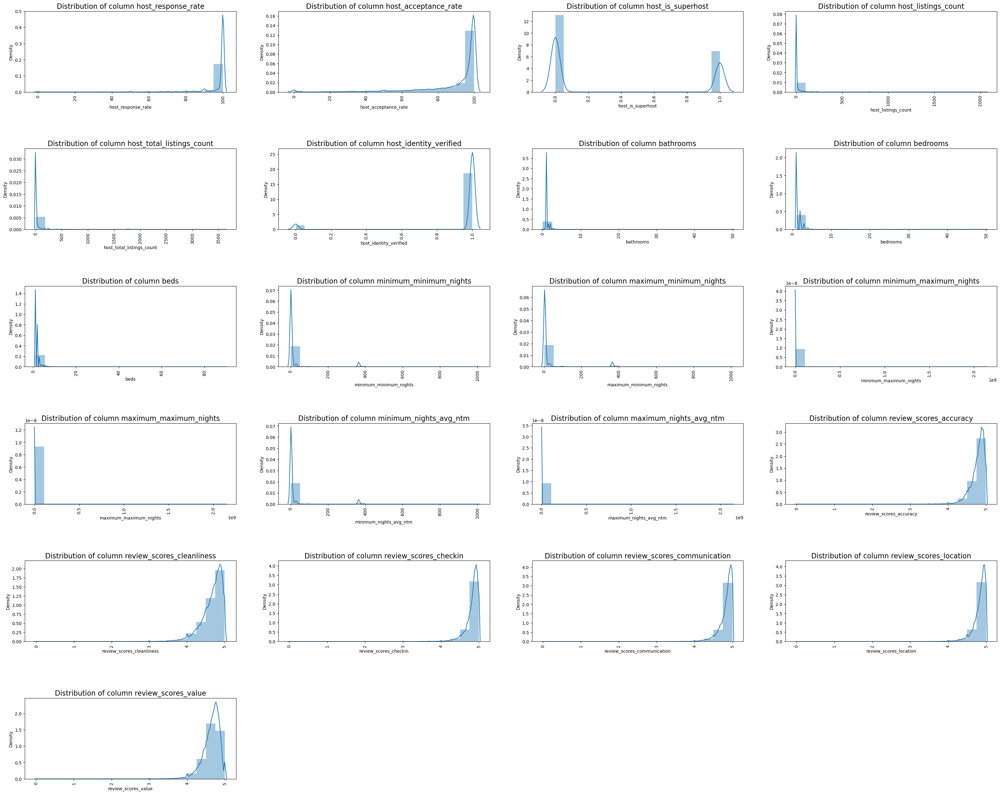

In [37]:
# look at the distribution of Missing Columns by using dist plot:
missing = numeric_columns[numeric_columns.columns[numeric_columns.isnull().any()]]
plt.figure(figsize=(40,50))
for i,col in enumerate(missing.columns):
    plt.subplot(6,4,i+1)
    sns.distplot(numeric_columns[col],bins=20)
    plt.title(f'Distribution of column {col}',fontsize=16)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=0.7, top=0.6)
plt.show()

- In handling missing values, several techniques, including KNN imputation, statistical imputation, regression imputation and etc. can be employed. I decided on a statistical approach due to time restrictions and simplicity. 
As shown, the columns have a lot of skewness, so median imputation rather than mean imputation was chosen to represent the data distribution more accurately.

In [38]:
# Imputing Missing value by Median: 
df_Imputed = df.copy()

missingvalue_columns = ['host_response_rate','host_acceptance_rate','host_listings_count','host_total_listings_count','minimum_minimum_nights','maximum_minimum_nights','minimum_maximum_nights','maximum_maximum_nights','minimum_nights_avg_ntm','review_scores_rating','review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value','reviews_per_month','maximum_nights_avg_ntm']
for col in missingvalue_columns:
    df_Imputed.loc[:, col] = df_Imputed.loc[:, col].fillna(df_Imputed.loc[:, col].median())

In [39]:
# Replace null values with 0:
missing_value_columns=['host_is_superhost','host_identity_verified','bathrooms','bedrooms','beds']
for col in missing_value_columns:
    df_Imputed[col].fillna(0, inplace=True)

In [40]:
# Replace null values with value:
null_columns=['name','host_name','host_about','description','host_location','neighborhood_overview','host_neighbourhood','host_verifications','neighbourhood','amenities','comments']
for col in null_columns:
    df_Imputed[col].fillna('Unassigned', inplace=True)
    
df_Imputed['host_response_time'].fillna('NoResponse', inplace=True)

In [41]:
# Replace null values with forward fill (fill with previous data):
cols = ['last_review','first_review','host_since']
for col in cols:
    df_Imputed[col].fillna(method='ffill', inplace=True)

In [42]:
# Extract object columns:
nonnumeric_columns = df_Imputed.select_dtypes('object')
nonnumeric_columns.columns

Index(['comments', 'neighbourhood_cleansed', 'last_scraped', 'name',
       'description', 'neighborhood_overview', 'host_name', 'host_since',
       'host_location', 'host_about', 'host_response_time',
       'host_neighbourhood', 'host_verifications', 'neighbourhood',
       'property_type', 'room_type', 'amenities', 'calendar_last_scraped',
       'first_review', 'last_review'],
      dtype='object')

In [43]:
# Extract numeric columns:
numeric_columns = df_Imputed.select_dtypes(exclude=['object','geometry','datetime64[ns]'])
numeric_columns.columns

Index(['listing_id', 'reviewer_id', 'host_id', 'host_response_rate',
       'host_acceptance_rate', 'host_is_superhost', 'host_listings_count',
       'host_total_listings_count', 'host_identity_verified', 'latitude',
       'longitude', 'accommodates', 'bathrooms', 'bedrooms', 'beds', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'has_availability', 'availability_30',
       'availability_60', 'availability_90', 'availability_365',
       'number_of_reviews', 'number_of_reviews_ltm', 'number_of_reviews_l30d',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'instant_bookable',
       'calculated_host_listings_count',
       'calculated_host_list

#### 4. Analyzing Dataset: 

In [44]:
# Look at the Data Set:
df_Imputed.head().style.background_gradient(cmap='Blues').set_table_styles([{'selector' : '','props' : [('border','1px solid darkblue')]}])

,listing_id,reviewer_id,comments,neighbourhood_cleansed,geometry,last_scraped,name,description,neighborhood_overview,host_id,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_identity_verified,neighbourhood,latitude,longitude,property_type,room_type,accommodates,bathrooms,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,5396,19995,"Perfect location!! Nasrine was a delight and made the whole process very easy. We also had a problem with construction noise, but it's good that they're doing some upkeep on the building. Thanks for a lovely stay in Paris. We'll be back!",Hôtel-de-Ville,"MULTIPOLYGON (((2.368512 48.855734, 2.369003 48.853741, 2.369103 48.853311, 2.369106 48.853301, 2.369107 48.853296, 2.369114 48.853265, 2.36913 48.853197, 2.369135 48.853176, 2.369138 48.853163, 2.36913 48.853146, 2.369102 48.853086, 2.369079 48.853036, 2.369078 48.853034, 2.368872 48.852591, 2.36881 48.852455, 2.368802 48.852438, 2.368739 48.852301, 2.368671 48.852158, 2.368637 48.852085, 2.368613 48.852034, 2.368612 48.852033, 2.368601 48.852007, 2.368599 48.852003, 2.368574 48.85195, 2.368419 48.851616, 2.368418 48.851614, 2.368386 48.851545, 2.368031 48.850764, 2.367991 48.850677, 2.367312 48.849181, 2.367309 48.849176, 2.36652 48.84741, 2.366503 48.847371, 2.366145 48.847159, 2.366137 48.847154, 2.366117 48.847142, 2.365968 48.847053, 2.365942 48.847038, 2.365695 48.846891, 2.365686 48.846885, 2.365682 48.846883, 2.36565 48.846864, 2.365606 48.846838, 2.365561 48.846811, 2.365548 48.846803, 2.365485 48.846766, 2.365483 48.846765, 2.365379 48.846703, 2.365367 48.846695, 2.364433 48.84614, 2.362493 48.847622, 2.361892 48.847992, 2.361515 48.848232, 2.360799 48.848632, 2.360798 48.848633, 2.359816 48.849182, 2.359693 48.849244, 2.359569 48.849305, 2.359351 48.849404, 2.359175 48.849479, 2.358873 48.849594, 2.358545 48.849709, 2.35833 48.849778, 2.35825 48.849804, 2.358148 48.849839, 2.358057 48.849866, 2.357998 48.849885, 2.355649 48.850642, 2.355599 48.850658, 2.355512 48.850686, 2.355348 48.850735, 2.353706 48.851221, 2.353185 48.8513, 2.352516 48.85139, 2.351601 48.851594, 2.350223 48.851947, 2.350043 48.852, 2.34998 48.852021, 2.349907 48.852045, 2.349874 48.852057, 2.349641 48.85214, 2.349382 48.852241, 2.34926 48.852292, 2.34847 48.852612, 2.346947 48.853294, 2.346872 48.853319, 2.346819 48.853335, 2.344786 48.853987, 2.344702 48.854013, 2.344593 48.854049, 2.344593 48.85405, 2.34587 48.855277, 2.345901 48.855314, 2.345975 48.855417, 2.345976 48.855418, 2.346104 48.855587, 2.346803 48.856708, 2.346986 48.857009, 2.347053 48.857079, 2.347184 48.857163, 2.347184 48.857164, 2.347299 48.857215, 2.347518 48.857312, 2.347519 48.857312, 2.347565 48.857349, 2.348208 48.858495, 2.34822 48.858516, 2.349366 48.860576, 2.349454 48.860733, 2.350156 48.861991, 2.351652 48.861651, 2.353341 48.861273, 2.353473 48.861218, 2.356862 48.86008, 2.356903 48.860066, 2.358355 48.859022, 2.358808 48.858696, 2.359318 48.858356, 2.359372 48.858323, 2.360695 48.857692, 2.361751 48.857251, 2.362831 48.856904, 2.364304 48.856455, 2.36445 48.856409, 2.368512 48.855734)))",2023-03-14,Explore the heart of old Paris,"Cozy, w

In [45]:
# Get Statistical Information Summary for Numerical Columns:
df_Imputed.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
listing_id,1406845.0,5.325986e+16,1.800769e+17,5396.00000,7.215260e+06,2.007149e+07,3.855923e+07,8.428064e+17
reviewer_id,1406845.0,1.226696e+08,1.274491e+08,81.00000,2.506716e+07,7.247908e+07,1.811222e+08,5.048448e+08
host_id,1406845.0,9.898585e+07,1.303561e+08,275.00000,1.014841e+07,3.627722e+07,1.352598e+08,5.044971e+08
host_response_rate,1406845.0,9.757728e+01,9.423599e+00,0.00000,1.000000e+02,1.000000e+02,1.000000e+02,1.000000e+02
host_acceptance_rate,1406845.0,9.108361e+01,1.695849e+01,0.00000,9.200000e+01,9.800000e+01,1.000000e+02,1.000000e+02
host_is_superhost,1406845.0,3.474015e-01,4.761448e-01,0.00000,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00
host_listings_count,1406845.0,1.504114e+01,6.235138e+01,1.00000,1.000000e+00,1.000000e+00,5.000000e+00,2.066000e+03
host_total_listings_count,1406845.0,2.396893e+01,1.275933e+02,1.00000,1.000000e+00,2.000000e+00,6.000000e+00,3.629000e+03
host_identity_verified,1406845.0,9.342586e-01,2.478297e-01,0.00000,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00
latitude,1406845.0,4.886324e+01,1.668062e-02,48.81608,4.885210e+01,4.886442e+01,4.887475e+01,4.890159e+01


- Average Host Response Rate is 97.6%.
- Average Host Acceptance Rate is 91%.

- Average Host Listing Count is 15, Minimum and Maximum of Host Listing are 1 and 2066 respectively.
- Average Host Total Listing Count is 24, Minimum and Maximum of Host Listing are 1 and 3629 respectively.
- Average Calculated Count of Host Listings is 10.21, Minimum and Maximum are 1 and 447.
- Average Calculated Count of Host Listings Entire Homes is 9.29, Minimum and Maximum are 0 and 447.
- Average Calculated Count of Host Listings Private Rooms is 0.6, Minimum and Maximum are 0 and 91.
- Average Calculated Count of Host Listings Shared Rooms is 0.03, Minimum and Maximum are 0 and 10.

- Average 35% of Hosts are Super Host.
- Average 93% of Hosts'Identity are Verified. 
- Average 100% of Listing are Available.
- Average 27% of Listing are Instant Bookable.

- Average Accomodates is for 3 person, Minimum and Maximum of Accommodates are 0 and 16 respectively.
- Average bathrooms is around 1.
- Average bedrooms is  around 1.
- Average beds is around 2.

- Average Minimum Nights is 24, Minimum and Maximum of Host Listing are 1 and 1000 respectively.
- Average Maximum Nights is 638, Minimum and Maximum of Host Listing are 1 and 85554 respectively.
- Average Minimum Minimum Nights is 24.	
- Average Maximum Minimum Nights is 25.	
- Average Minimum Maximum Nights is 2258.
- Average Maximum Maximum Nights is 17574.	
- Average Minimum Nights Avg. ntm is 24.	
- Average Maximum Nights Avg. ntm is 5424.

- Average Listing Availability in 30 days is 4 days.
- Average Listing Availability in 60 days is 11 days.
- Average Listing Availability in 90 days is 19 days.
- Average Listing Availability in 365 days is 117 days.

- Average Number of Reviews is 144.36, Minimum and Maximum are 1 and 2524 respectively.
- Average Number of Reviews ltm is 32.67, Minimum and Maximum are 0 and 964 respectively.
- Average Number of Reviews per Month is 2.51, Minimum and Maximum are 0.01 and 49.55 respectively.
- Average Number of Reviews l30d is 2.23, Minimum and Maximum are 0 and 93 respectively.
- Average Review Scores Rating is 4.70, Minimum and Maximum are 0 and 5 respectively.	
- Average Review Scores Accuracy is 4.78, Minimum and Maximum are 0 and 5 respectively.	
- Average Review Scores Cleanliness is 4.67, Minimum and Maximum are 0 and 5 respectively.	
- Average Review Scores Checkin is 4.83, Minimum and Maximum are 0 and 5 respectively.	
- Average Review Scores Communication is 4.83, Minimum and Maximum are 0 and 5 respectively.
- Average Review Scores Location is 4.83, Minimum and Maximum are 0 and 5 respectively.	
- Average Review Scores Value is 4.64, Minimum and Maximum are 0 and 5 respectively.

- Average Price for Listing is 170.26 dollar, Minimum and Maximum are 0 and 93000 dollar respectively.

In [46]:
# Get Statistical Information Summary for Numerical Columns:
df_Imputed.describe(include='O').transpose()

,count,unique,top,freq
comments,1406845,1351185,.,1701
neighbourhood_cleansed,1406845,20,Popincourt,126770
last_scraped,1406845,4,2023-03-14,1149759
name,1406845,44175,"Double/Twin Room, close to Opera and the Louvr...",2524
description,1406845,44635,PERMANENT RECEPTION & ARRIVAL <br />Receptioni...,3035
neighborhood_overview,1406845,24480,Unassigned,410524
host_name,1406845,7588,Joffrey,17215
host_since,1406845,4405,2019-09-10,8339
host_location,1406845,1373,"Paris, France",1104964
host_about,1406845,15568,Unassigned,542078


- The Most Cleansed Neighbourhood is Popincourt.
- The Highest Number of Last Scraped Listing is for date 2023-03-14.
- The Most Listing Name is for Double/Twin Room, close to Opera and the Louvr... .
- The Highest Number of Listing is for Host Location in Paris, France.
- The Most of the Host Response Time is within an hour.
- The Most Host Verifications Method is 'email', 'phone'.
- The Highest Listing Number is for Paris, Île-de-France, France Neighbourhood.
- The Most Property Type is Entire Rental Unit.
- The Most Room Type is Entire Home/Apt.
- The Most Amenities is "Heating", "Air conditioning", "TV", "Hangers... .
- The Highest Number of Calendar Last Scraped is for date 2023-03-14.
- The Highest Number of First Review is for date 2017-05-07.
- The Highest Number of Last Review is for date 2023-02-26.

In [47]:
# Look at the Columns Correlation by Using HeatMap:
plt.figure(figsize=(100,100))
sns.heatmap(df_Imputed.corr(),annot=True, linewidths=0.1, fmt='.2f' )

<AxesSubplot:>

Text(0.5, 1.0, 'Distribution of Numerical Columns')

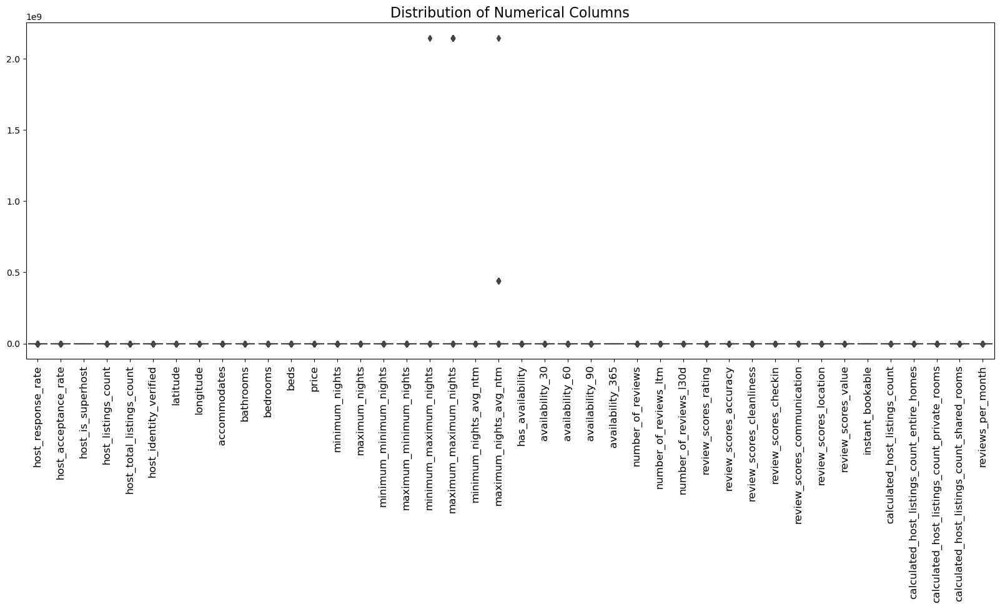

In [48]:
# Look at the Distribution of Columns:
plt.figure(figsize=(20,7))
sns.boxplot(data=df_Imputed.drop(['listing_id','host_id','reviewer_id'],axis=1))
plt.xticks(rotation=90, fontsize=12)
plt.title('Distribution of Numerical Columns',fontsize=16)

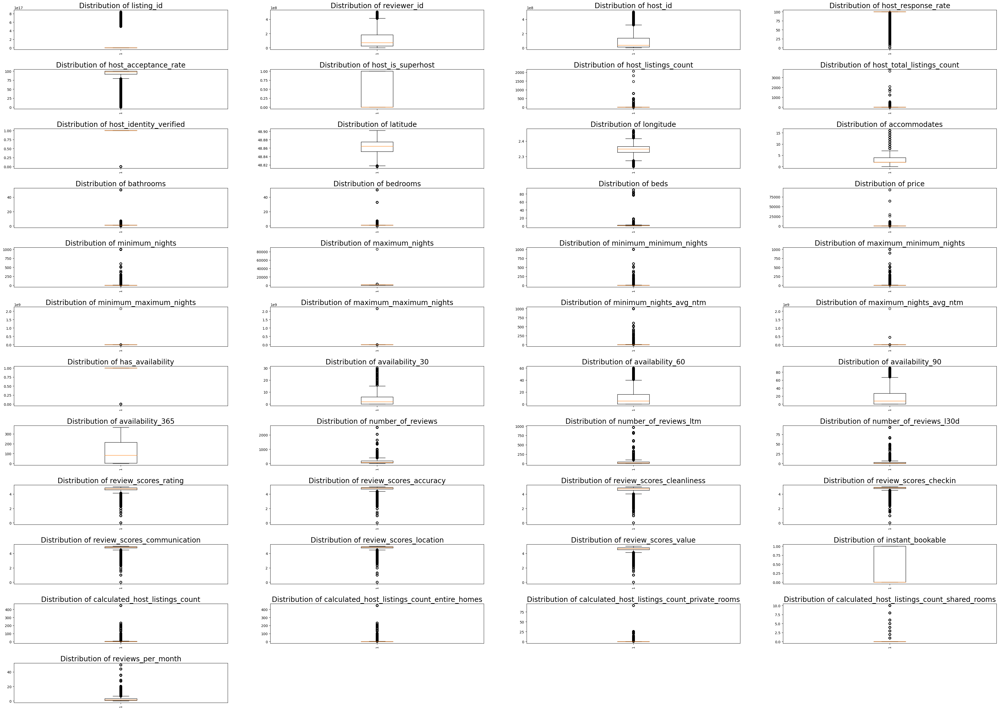

In [49]:
# Look at the Outliers of columns by Boxplot:
plt.figure(figsize=(50,70))
for i,col in enumerate(numeric_columns.columns):
    plt.subplot(12, 4, i+1)
    plt.boxplot(numeric_columns[col]) 
    plt.title(f'Distribution of {col}',fontsize=20)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace = 0.5, top = 0.5)
plt.show()

In [50]:
# Look at the dataset pairplot:
# plt.figure(figsize=(50,50))
# sns.set(font_scale=0.8)
# sns.pairplot(data=numeric_columns)

###### 4.1. Hosts Analyzing:

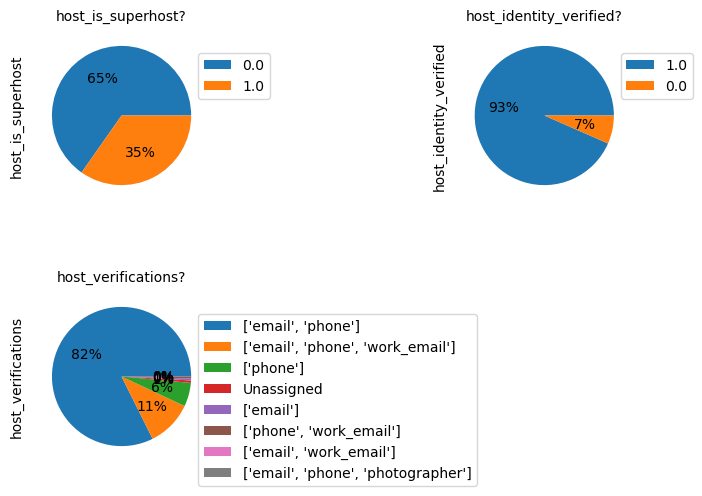

In [51]:
# Look at the Host Distribution:
cols= ['host_is_superhost', 'host_identity_verified', 'host_verifications']

plt.figure(figsize=(10,15))
for i,col in enumerate(cols):
    plt.subplot(2,2,i+1)
    df_Imputed[col].value_counts().plot(kind='pie', autopct='%1.0f%%', labels=None)
    plt.title(f'{col}?',fontsize=10)
    labels = df_Imputed[col].value_counts().sort_values(ascending=False).index
    plt.legend(labels=labels, loc='upper left', bbox_to_anchor=(0.9,0.9), fontsize=10)
plt.subplots_adjust(hspace=0.5, top=0.4)

<AxesSubplot:title={'center':'Top 10 Verified Host Identity:'}, xlabel='host_id'>

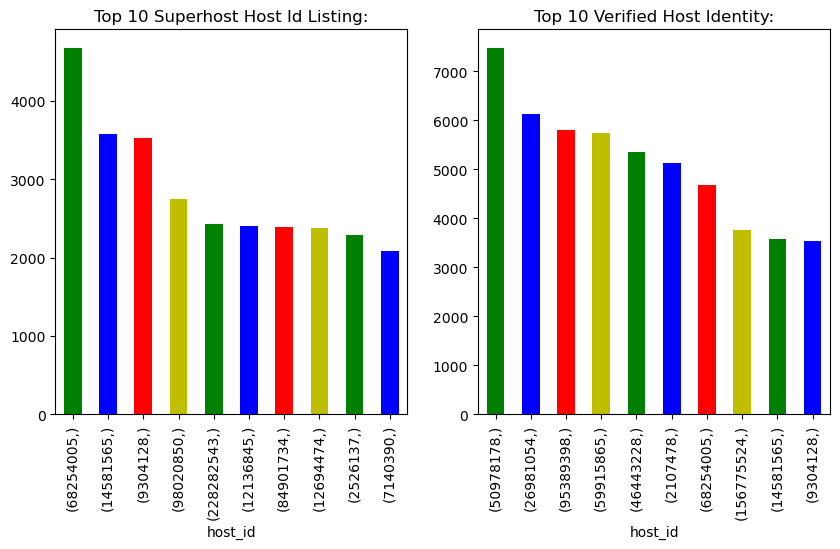

In [52]:
# Look at the Top 10 Verified Host Identity and Top 10 Super Host Listing:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
df_Imputed[df_Imputed.host_is_superhost==1][['host_id']].value_counts().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"], title='Top 10 Superhost Host Id Listing:')
plt.subplot(1,2,2)
df_Imputed[df_Imputed.host_identity_verified==1][['host_id']].value_counts().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"], title='Top 10 Verified Host Identity:')

<AxesSubplot:title={'center':'Top 10 Available Host:'}, xlabel='host_id'>

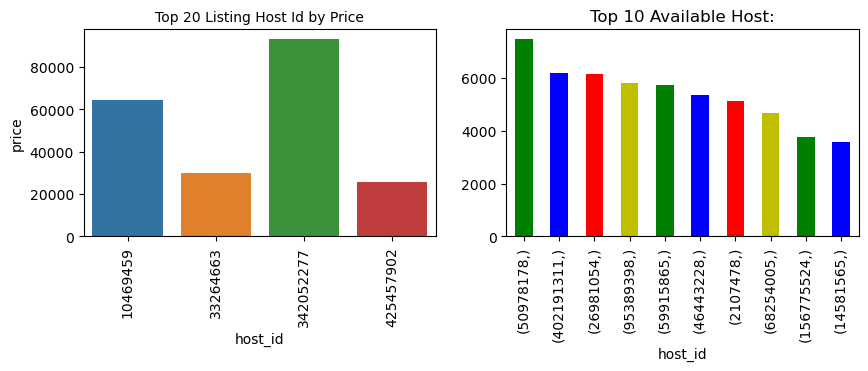

In [53]:
# Look at the Top 20 Price of Hosts' Property:
plt.figure(figsize=(10,3))
plt.subplot(121)
price = df_Imputed[['price','host_id']].sort_values(by='price',ascending=False).head(20)
sns.barplot(x=price['host_id'],y=price['price'])
plt.title(f'Top 20 Listing Host Id by Price',fontsize=10)
plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1.0, top=0.8)

# Top 10 Available Host:
plt.subplot(122)
df_Imputed[df_Imputed.has_availability==1][['host_id']].value_counts().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"], title='Top 10 Available Host:')

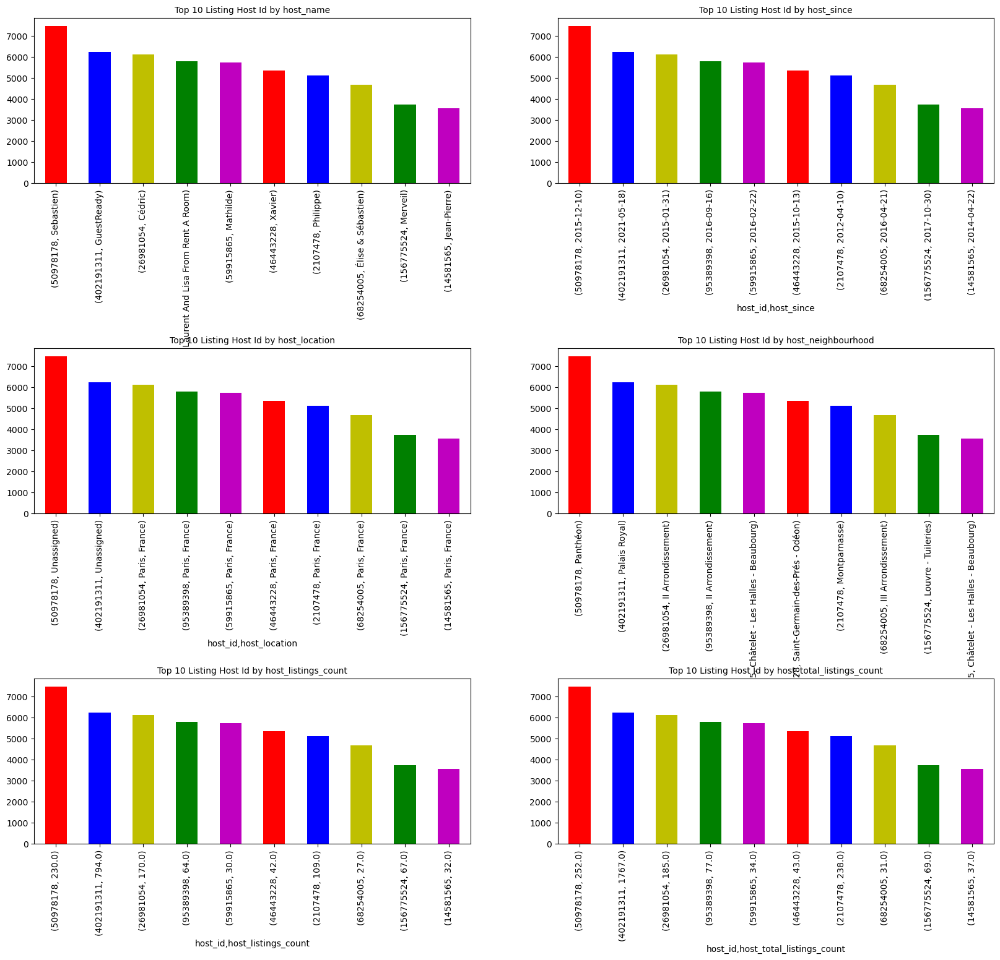

In [54]:
# Look at the top 10 Host Listing:
host= ['host_name','host_since','host_location','host_neighbourhood','host_listings_count','host_total_listings_count']
plt.figure(figsize=(20,15))
for i,col in enumerate(host):
    plt.subplot(3,2,i+1)
    df_Imputed.groupby('host_id')[col].value_counts().sort_values(ascending=False).head(10).plot(kind='bar',color=['r','b','y','g','m'])    
    plt.title(f'Top 10 Listing Host Id by {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1, top=1)
plt.show()

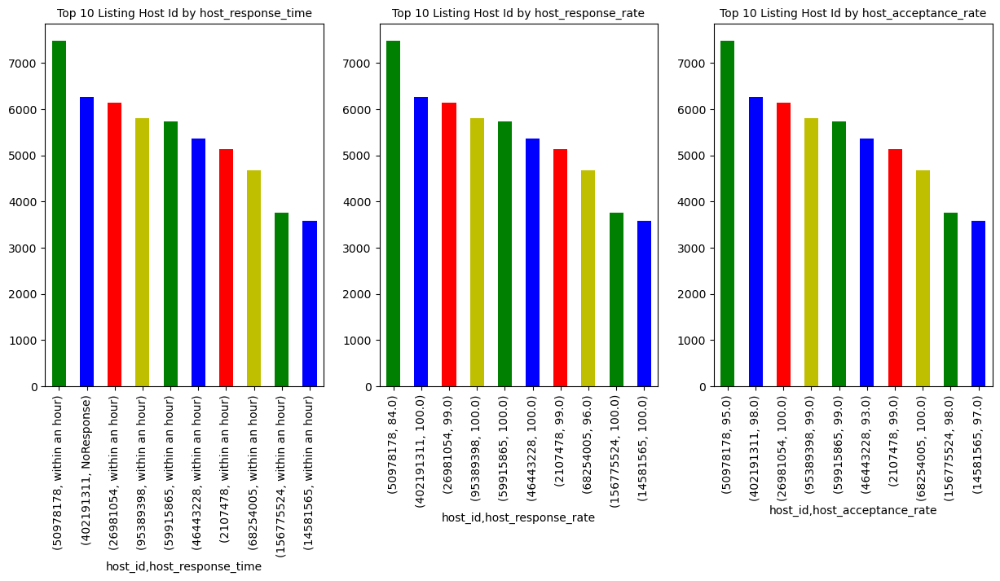

In [55]:
# Look at the top 10 Listing Host:
host= ['host_response_time','host_response_rate','host_acceptance_rate']
plt.figure(figsize=(15,5))
for i,col in enumerate(host):
    plt.subplot(1,3,i+1)
    df_Imputed.groupby('host_id')[col].value_counts().sort_values(ascending=False).head(10).plot(kind='bar',color=["g","b","r","y"])    
    plt.title(f'Top 10 Listing Host Id by {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1, top=1)
plt.show()

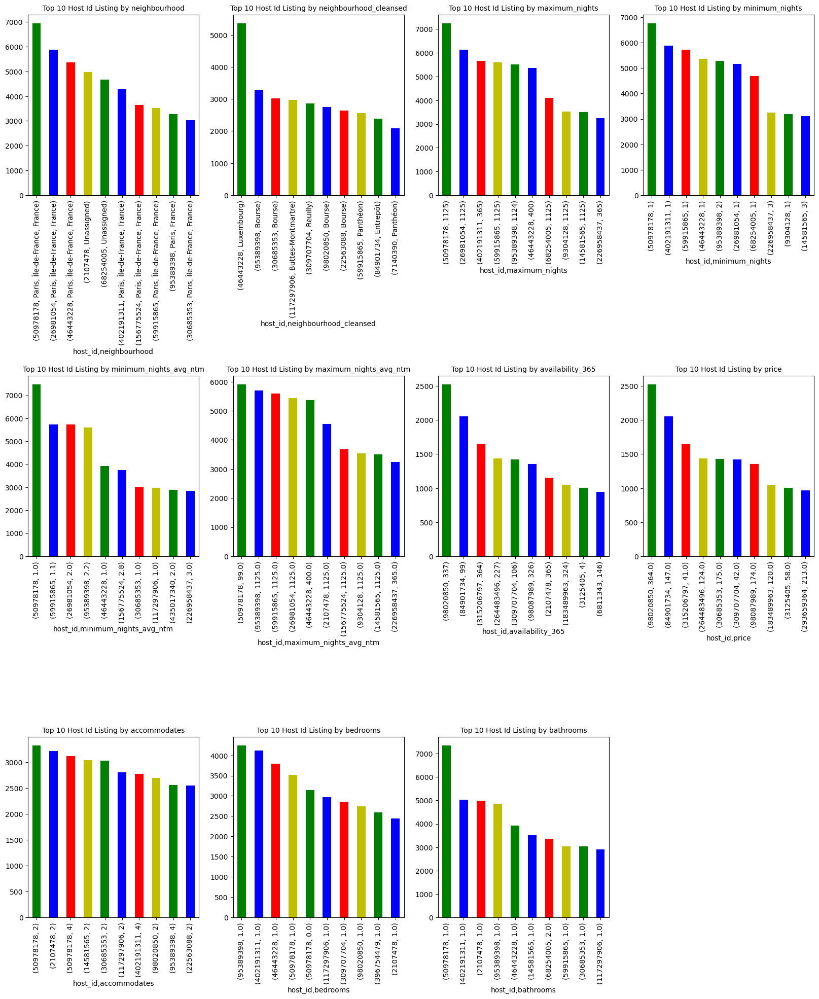

In [56]:
# Look at the top 10 Host Listing by Property Features:
host= ['neighbourhood','neighbourhood_cleansed','maximum_nights','minimum_nights','minimum_nights_avg_ntm','maximum_nights_avg_ntm','availability_365','price','accommodates','bedrooms','bathrooms']
plt.figure(figsize=(20,20))
for i,col in enumerate(host):
    plt.subplot(3,4,i+1)
    df_Imputed.groupby('host_id')[col].value_counts().sort_values(ascending=False).head(10).plot(kind='bar',color=["g","b","r","y"])    
    plt.title(f'Top 10 Host Id Listing by {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1, top=1)
plt.show()

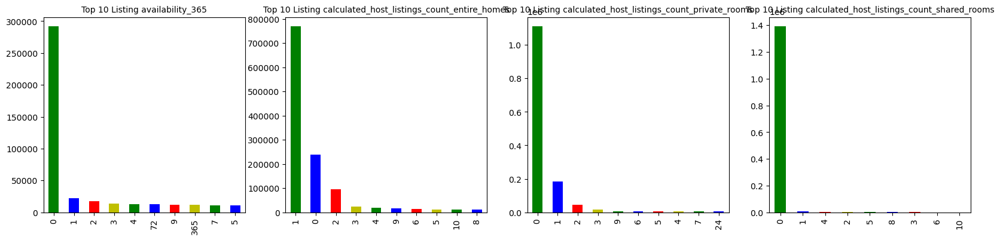

In [57]:
# Look at the Availability and Host Listing Property Type
cols=['availability_365','calculated_host_listings_count_entire_homes','calculated_host_listings_count_private_rooms',
'calculated_host_listings_count_shared_rooms'] 
plt.figure(figsize=(20,3))
for i,col in enumerate(cols):
    plt.subplot(1,4,i+1)
    df_Imputed[col].value_counts().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"])    
    plt.title(f'Top 10 Listing {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1.2, top=1.2)
plt.show()

##### 4.2. Neighbourhood Analyzing:

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'Élysée'),
  Text(1, 0, 'Louvre'),
  Text(2, 0, 'Palais-Bourbon'),
  Text(3, 0, 'Luxembourg'),
  Text(4, 0, 'Bourse'),
  Text(5, 0, 'Hôtel-de-Ville'),
  Text(6, 0, 'Temple'),
  Text(7, 0, 'Passy'),
  Text(8, 0, 'Panthéon'),
  Text(9, 0, 'Vaugirard')])

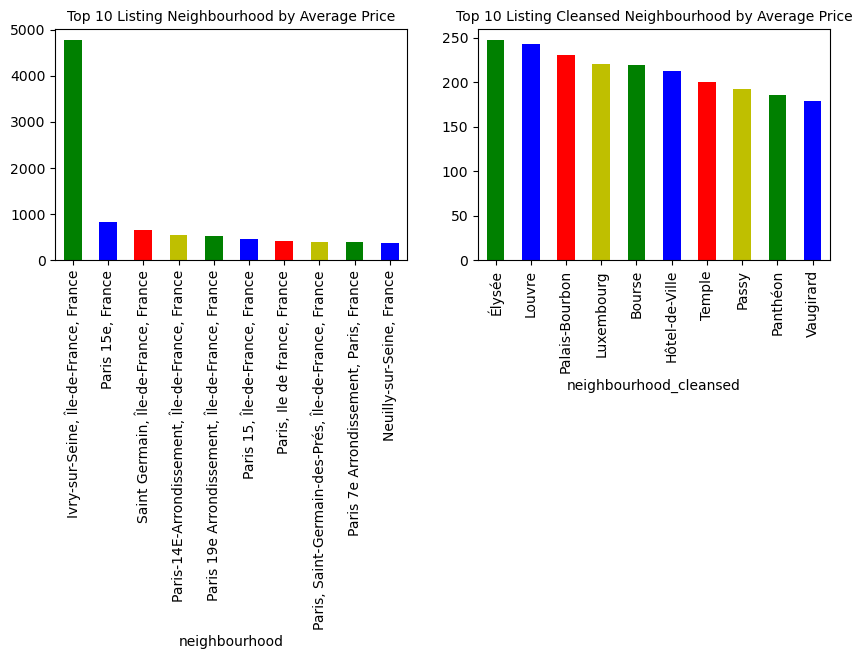

In [58]:
# Look at the Top 10 Listing Neighbourhood and Cleansed Neighbourhood by Average Price:
plt.figure(figsize=(10,3))
plt.subplot(121)
df_Imputed.groupby('neighbourhood')['price'].mean().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"])    
plt.title(f'Top 10 Listing Neighbourhood by Average Price',fontsize=10)
plt.xticks(rotation=90)

plt.subplot(122)
df_Imputed.groupby('neighbourhood_cleansed')['price'].mean().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"])    
plt.title(f'Top 10 Listing Cleansed Neighbourhood by Average Price',fontsize=10)
plt.xticks(rotation=90)

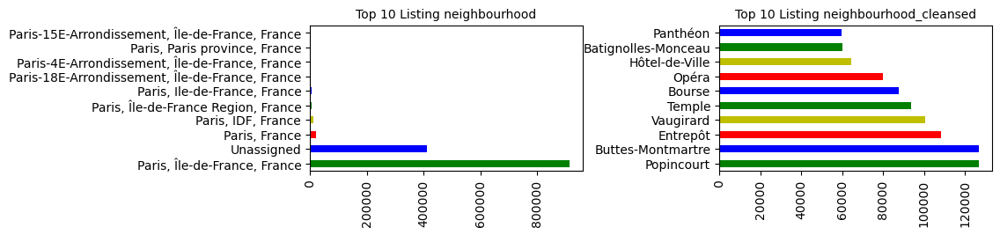

In [59]:
# Look at the top 10 Neigborhood Listing:
neighbourhood= ['neighbourhood','neighbourhood_cleansed']
plt.figure(figsize=(10,7))
for i,col in enumerate(neighbourhood):
    plt.subplot(2,2,i+1)
    df_Imputed[col].value_counts().sort_values(ascending=False).head(10).plot.barh(color=["g","b","r","y"])    
    plt.title(f'Top 10 Listing {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(wspace=0.5,hspace=0.5, top=0.7)
plt.show()

In [60]:
# Making Interactive Map:
lat = df_Imputed['latitude'].tolist()
long = df_Imputed['longitude'].tolist()
locations = list(zip(lat, long))

maps = folium.Map(location=[48.8566, 2.3522], zoom_start=12)
FastMarkerCluster(data=locations).add_to(maps)
maps

In [61]:
# Creat Cleansed Neighbourhoos Dataset with Average Price: 
df_geo = df_Imputed.groupby('neighbourhood_cleansed')['price'].mean().reset_index()
# Rename Column name:
df_geo.head()

,neighbourhood_cleansed,price
0,Batignolles-Monceau,154.109108
1,Bourse,218.917125
2,Buttes-Chaumont,100.856173
3,Buttes-Montmartre,123.598261
4,Entrepôt,149.830084


In [62]:
# Merge Two Dataset:
df_geo = pd.merge(df3,df_geo, on = 'neighbourhood_cleansed', how = "left")
df_geo.head()

,neighbourhood_cleansed,geometry,price
0,Batignolles-Monceau,"MULTIPOLYGON (((2.29517 48.87396, 2.29504 48.8...",154.109108
1,Palais-Bourbon,"MULTIPOLYGON (((2.32090 48.86306, 2.32094 48.8...",229.910701
2,Buttes-Chaumont,"MULTIPOLYGON (((2.38943 48.90122, 2.39014 48.9...",100.856173
3,Opéra,"MULTIPOLYGON (((2.33978 48.88203, 2.33982 48.8...",177.713462
4,Entrepôt,"MULTIPOLYGON (((2.36469 48.88437, 2.36485 48.8...",149.830084


In [63]:
# Making Map Dictionary and Colors:
maps_dict = df_geo.set_index('neighbourhood_cleansed')['price'].to_dict()
colors = LinearColormap(['red','green'], vmin = min(maps_dict.values()), vmax = max(maps_dict.values()))
colors

In [64]:
# Making Interactive Neighborhood Map by Averaged Price:
def get_color(feature):
    value = maps_dict.get(feature['properties']['neighbourhood_cleansed'])
    return colors(value)

maps = folium.Map(location=[48.8566, 2.3522], zoom_start=12)
folium.GeoJson(data=df_geo,
               name='Paris',
               tooltip=folium.features.GeoJsonTooltip(fields=['neighbourhood_cleansed', 'price'],labels=True,sticky=False),
               style_function= lambda feature: {'fillColor': get_color(feature),'color': 'black','weight': 1,'fillOpacity':0.7
                   },
               highlight_function=lambda feature: {'weight':1, 'fillColor': get_color(feature), 'fillOpacity': 0.7}).add_to(maps)
maps

##### 4.3. Property and Room Type:

In [65]:
# Look at the Percentage of Room Type: 
plt.figure(figsize=(5,3))
prop = df_Imputed.groupby('room_type').size()/df_Imputed['room_type'].count()*100
labels = prop.index
values = prop.values
# Create a Donut Pie Chart:
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.show()

<Figure size 500x300 with 0 Axes>

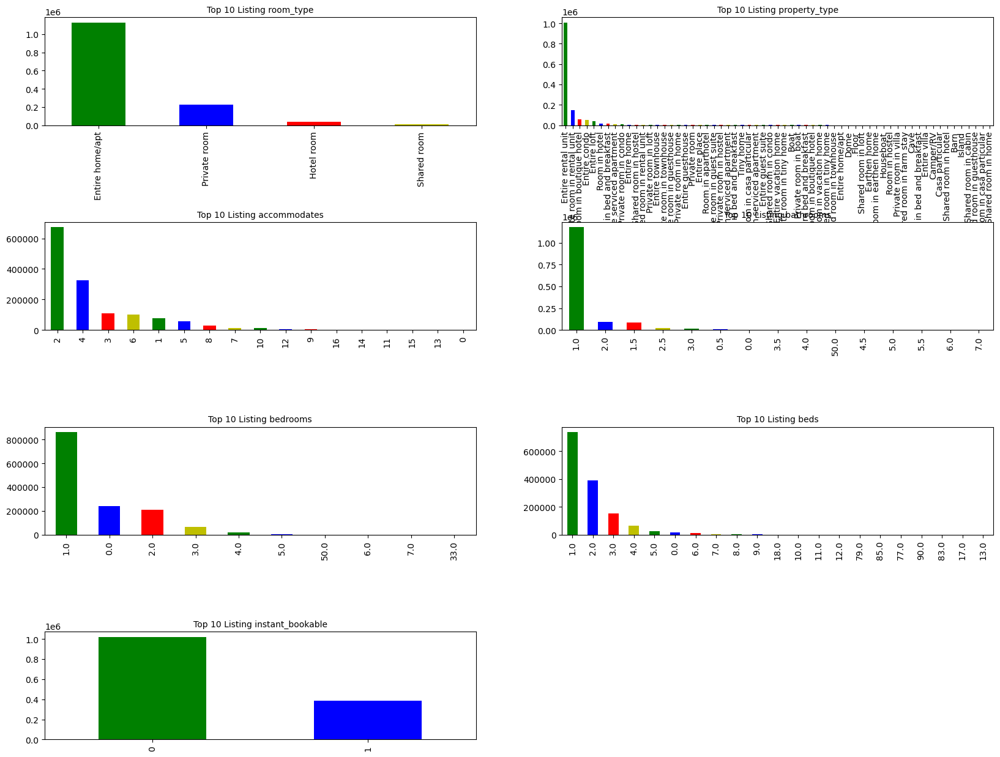

In [66]:
# Look at the Property Features:
Property = ['room_type','property_type','accommodates','bathrooms','bedrooms','beds','instant_bookable']
plt.figure(figsize=(20,20))
for i,col in enumerate(Property):
    plt.subplot(4,2,i+1)
    df_Imputed[col].value_counts().sort_values(ascending=False).plot.bar(color=["g","b","r","y"])    
    plt.title(f'Top 10 Listing {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=0.9, top=0.7)
plt.show()

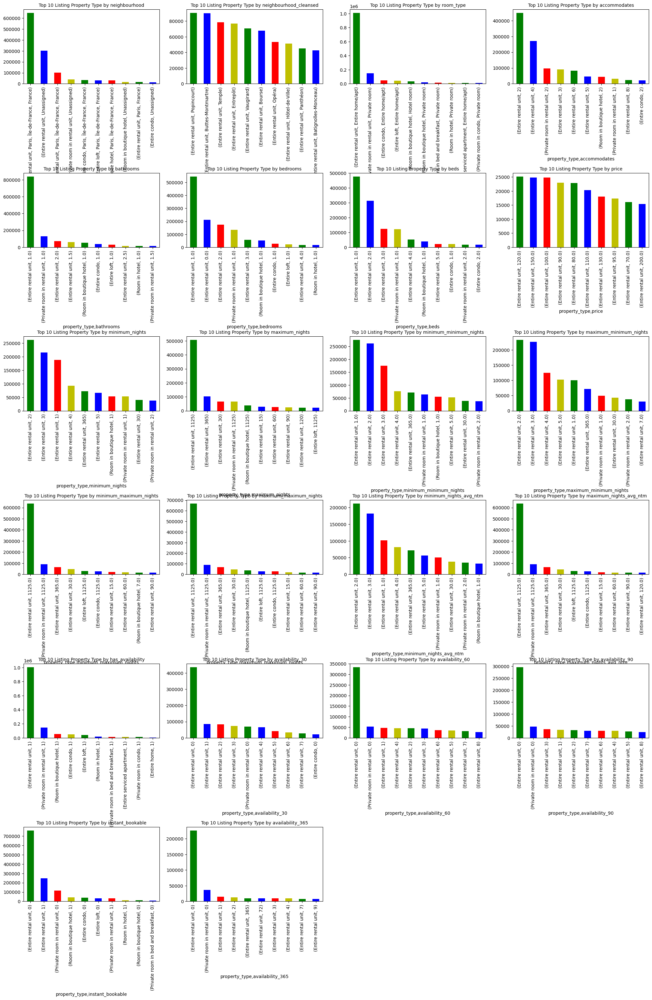

In [67]:
# Look at the top 10 Listing Property Type in Neigborhood:

Property = ['neighbourhood','neighbourhood_cleansed','room_type','accommodates','bathrooms','bedrooms',
            'beds','price','minimum_nights','maximum_nights','minimum_minimum_nights',
'maximum_minimum_nights','minimum_maximum_nights','maximum_maximum_nights','minimum_nights_avg_ntm','maximum_nights_avg_ntm',
'has_availability','availability_30','availability_60','availability_90','instant_bookable','availability_365']

plt.figure(figsize=(25,30))
for i,col in enumerate(Property):
    plt.subplot(7,4,i+1)
    df_Imputed.groupby('property_type')[col].value_counts().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"])    
    plt.title(f'Top 10 Listing Property Type by {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1.2, top=1.2)
plt.show()

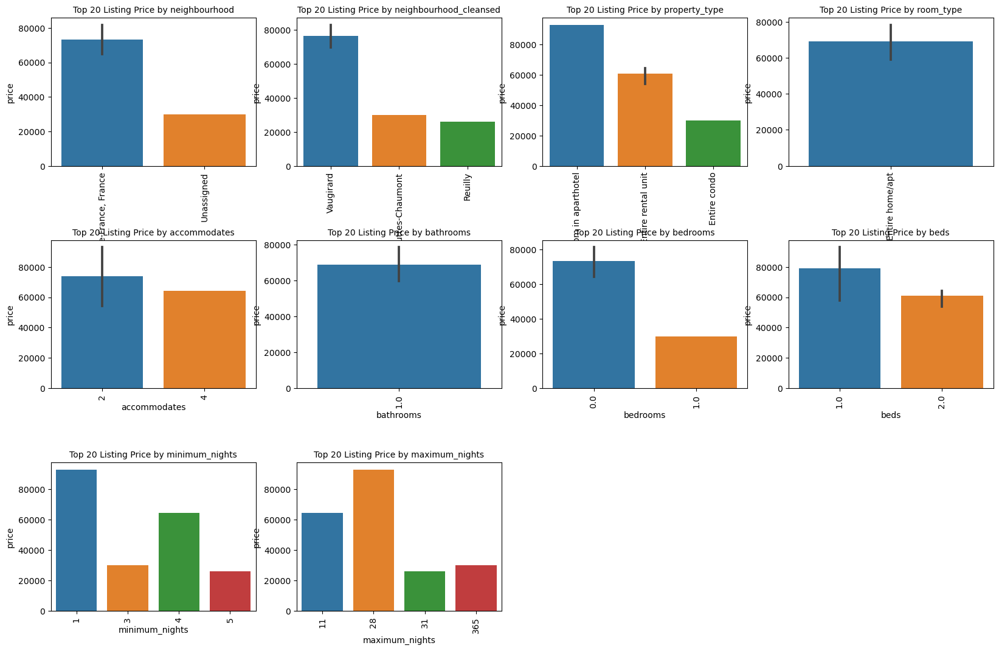

In [68]:
 # Look at the Top Price by Other Columns:
cols=['neighbourhood','neighbourhood_cleansed','property_type','room_type','accommodates','bathrooms','bedrooms',
'beds','minimum_nights','maximum_nights'] 
plt.figure(figsize=(20,25))
for i,col in enumerate(cols):
    plt.subplot(3,4,i+1)
    price=df_Imputed[['price',col]].sort_values(by='price',ascending=False).head(20) 
    sns.barplot(x=price[col],y=price['price'])
    plt.title(f'Top 20 Listing Price by {col}',fontsize=10)
    plt.xticks(rotation=90)

plt.subplots_adjust(hspace=0.5, top=0.5)

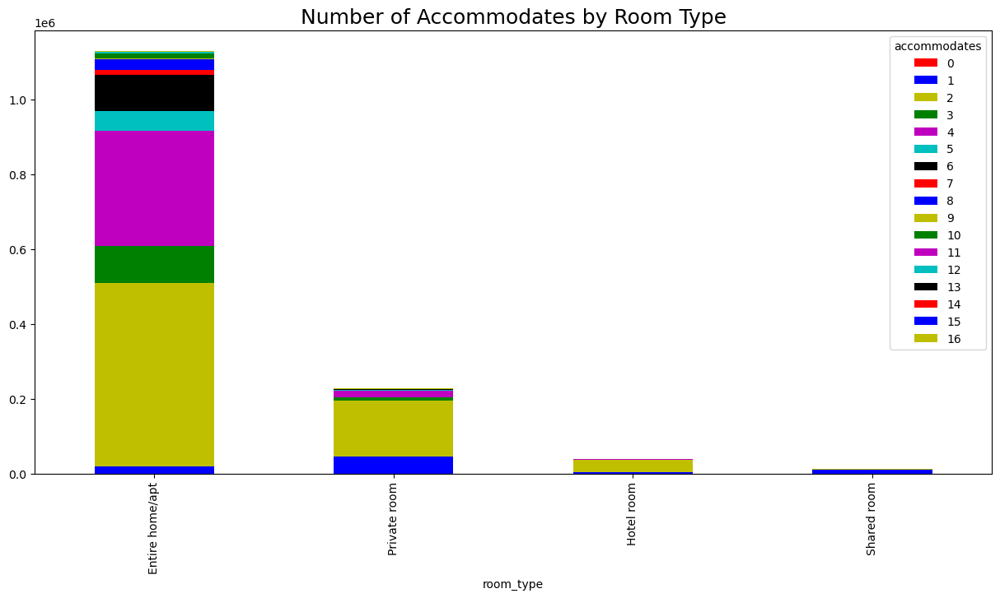

In [69]:
# Lokk at the Number of Accommodates by Room Type:
accomodates = df_Imputed.groupby(['room_type','accommodates']).accommodates.count()
accomodates = accomodates.unstack()
accomodates['total'] = accomodates.sum(axis = 1)
accomodates = accomodates.sort_values(by=['total'],ascending=False)
accomodates = accomodates.drop('total',axis=1)
accomodates.plot(kind='bar',stacked=True, color = ['r','b','y','g','m','c','k'], figsize=(15,7))
plt.title('Number of Accommodates by Room Type', fontsize=18)
plt.show()

Text(0.5, 1.0, 'Top 10 Listing Neighbourhood')

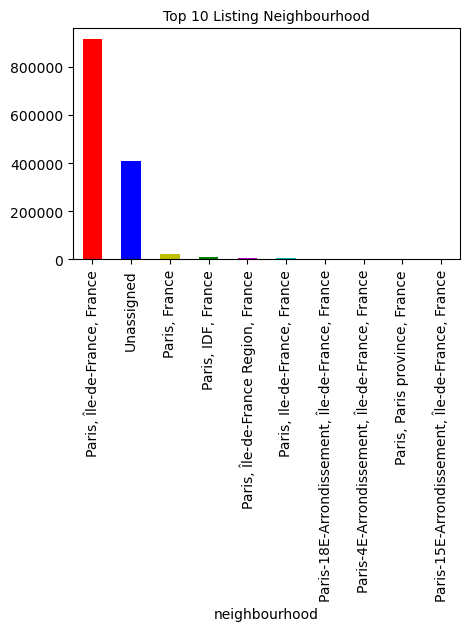

In [70]:
# Look at the Number of Listing In Neighbourhood:
df_Imputed.groupby('neighbourhood').size().sort_values(ascending=False).head(10).plot.bar(color = ['r','b','y','g','m','c'], figsize=(5,3))
plt.title(f'Top 10 Listing Neighbourhood',fontsize=10)

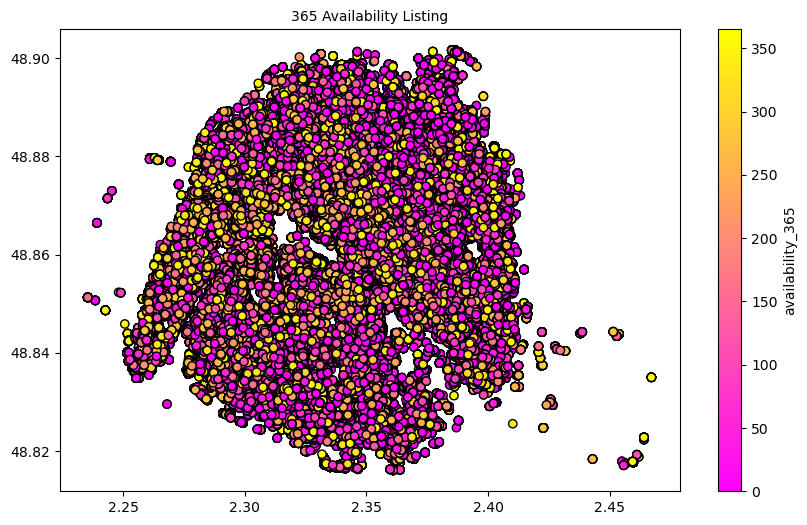

In [71]:
# Look at the 365 days Availablility: 
plt.figure(figsize=(10,6))
plt.scatter(df_Imputed['longitude'], df_Imputed['latitude'], c=df_Imputed['availability_365'], cmap='spring', edgecolor='black', alpha=1)
plt.title(f'365 Availability Listing',fontsize=10)
cbar = plt.colorbar()
cbar.set_label('availability_365')

###### 4.4. Reviews:

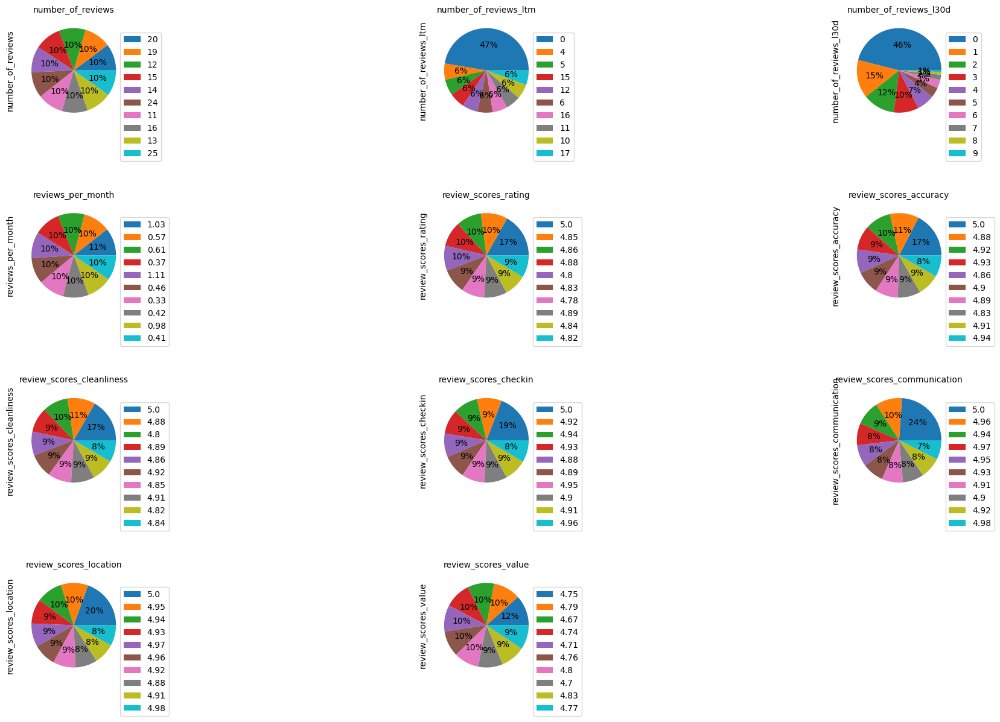

In [72]:
# Look at the Reviews:
cols= ['number_of_reviews','number_of_reviews_ltm','number_of_reviews_l30d','reviews_per_month','review_scores_rating','review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value']

plt.figure(figsize=(25,15))
for i,col in enumerate(cols):
    plt.subplot(4,3,i+1)
    df_Imputed[col].value_counts().sort_values(ascending=False).head(10).plot(kind='pie', autopct='%1.0f%%', labels=None)
    plt.title(f'{col}',fontsize=10)
    labels = df_Imputed[col].value_counts().sort_values(ascending=False).head(10).index
    plt.legend(labels=labels, loc='upper left', bbox_to_anchor=(0.9,0.9), fontsize=10)
plt.subplots_adjust(hspace=0.75, top=0.84)

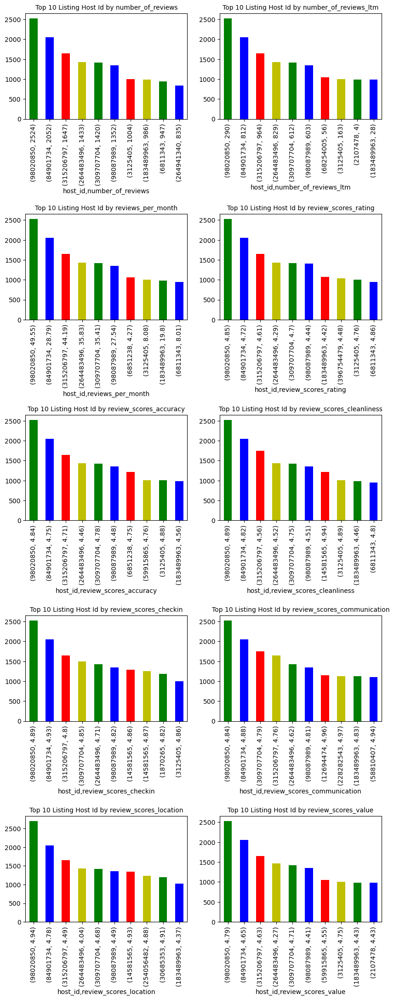

In [73]:
# Look at the Reviews:
cols= ['number_of_reviews','number_of_reviews_ltm','reviews_per_month','review_scores_rating','review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value']

plt.figure(figsize=(10,25))
for i,col in enumerate(cols):
    plt.subplot(5,2,i+1)
    df_Imputed.groupby('host_id')[col].value_counts().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y"])    
    plt.title(f'Top 10 Listing Host Id by {col}',fontsize=10)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=0.9, top=0.9)

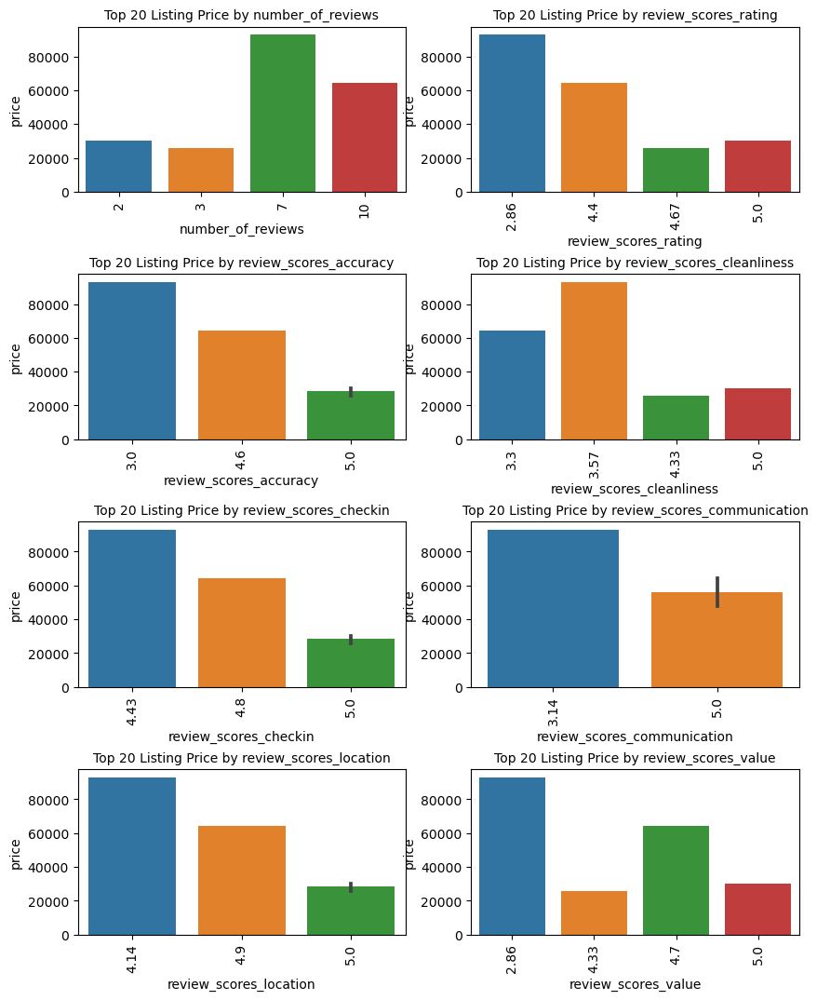

In [74]:
 # Look at the Top Price by Other Columns:
cols=['number_of_reviews','review_scores_rating','review_scores_accuracy', 'review_scores_cleanliness','review_scores_checkin',
'review_scores_communication','review_scores_location','review_scores_value'] 
plt.figure(figsize=(10,25))
for i,col in enumerate(cols):
    plt.subplot(4,2,i+1)
    price=df_Imputed[['price',col]].sort_values(by='price',ascending=False).head(20) 
    sns.barplot(x=price[col],y=price['price'])
    plt.title(f'Top 20 Listing Price by {col}',fontsize=10)
    plt.xticks(rotation=90)

plt.subplots_adjust(hspace=0.5, top=0.5)

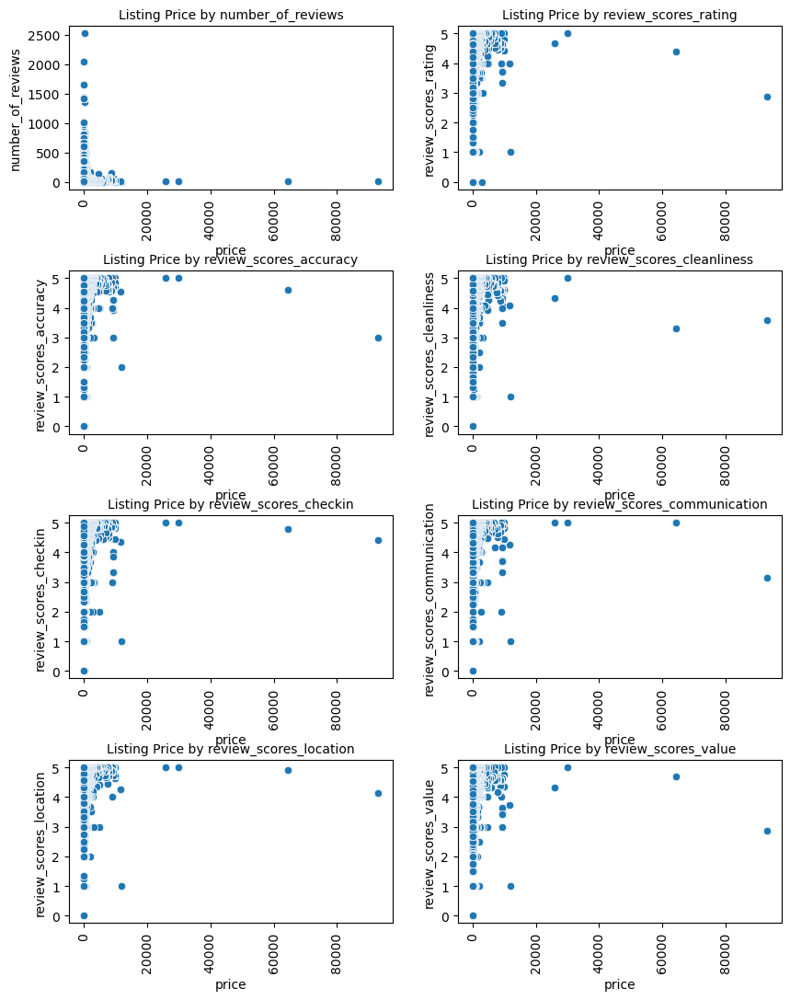

In [75]:
 # Look at the Price by Other Columns:
cols=['number_of_reviews','review_scores_rating','review_scores_accuracy', 'review_scores_cleanliness','review_scores_checkin',
'review_scores_communication','review_scores_location','review_scores_value'] 
plt.figure(figsize=(10,25))
for i,col in enumerate(cols):
    plt.subplot(4,2,i+1)
    price=df_Imputed[['price',col]].sort_values(by='price',ascending=False) 
    sns.scatterplot(x=price['price'],y=price[col])
    plt.title(f'Listing Price by {col}',fontsize=10)
    plt.xticks(rotation=90)

plt.subplots_adjust(hspace=0.5, top=0.5)

(array([-2.,  0.,  2.,  4.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

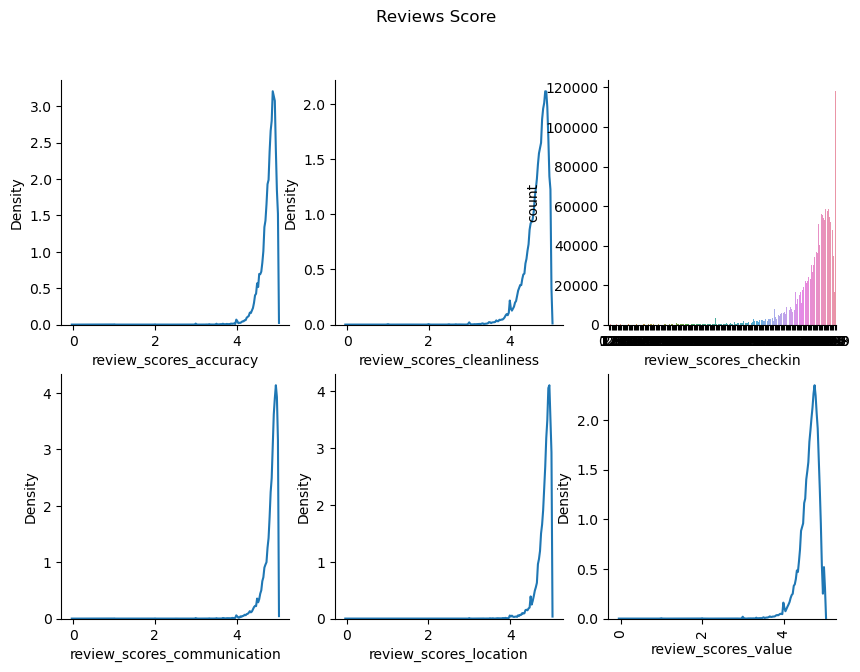

In [76]:
# Create the figure and axes:
fig, axs = plt.subplots(2, 3, figsize=(10,7))

# Plot the KDE plots
sns.kdeplot(df_Imputed['review_scores_accuracy'], ax=axs[0, 0])
sns.kdeplot(df_Imputed['review_scores_cleanliness'], ax=axs[0, 1])
sns.countplot(df_Imputed['review_scores_checkin'], ax=axs[0, 2])
sns.kdeplot(df_Imputed['review_scores_communication'], ax=axs[1, 0])
sns.kdeplot(df_Imputed['review_scores_location'], ax=axs[1, 1])
sns.kdeplot(df_Imputed['review_scores_value'], ax=axs[1, 2])
# Remove spines
sns.despine()

fig.suptitle('Reviews Score')
plt.xticks(rotation=90)
# Adjust subplot spacing
#lt.subplots_adjust(hspace=0.5, top=0.5)



In [77]:
# Extract Not Null comments:
df_reviews = df_Imputed[df_Imputed['comments'].notnull()]

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, '26244787'),
  Text(1, 0, '17222007'),
  Text(2, 0, '41020735'),
  Text(3, 0, '35145338'),
  Text(4, 0, '40194697'),
  Text(5, 0, '32518543'),
  Text(6, 0, '846954'),
  Text(7, 0, '32057469'),
  Text(8, 0, '1249964'),
  Text(9, 0, '35242476')])

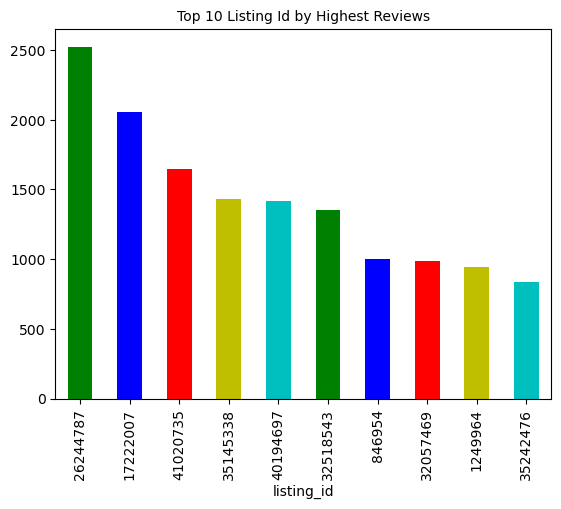

In [78]:
# Top 10 Listing Id by Highest Reviews:
df_reviews.groupby('listing_id').size().sort_values(ascending=False).head(10).plot.bar(color=["g","b","r","y","c"])    
plt.title(f'Top 10 Listing Id by Highest Reviews',fontsize=10)
plt.xticks(rotation=90)

In [79]:
# Removing Digit and Signs:
df_reviews['comments'] = df_reviews['comments'].str.replace('\d+','')
df_reviews['comments'] = df_reviews['comments'].str.replace('\r\n','')
df_reviews['comments'] = df_reviews['comments'].str.replace('\r<br/>','')
df_reviews['comments'] = df_reviews['comments'].str.replace('\<br/>','')
df_reviews['comments'] = df_reviews['comments'].str.lower()
# Remove Punctuation:
df_reviews['comments'] = df_reviews['comments'].str.replace('[^\w\s]','')
# replace spaces by one space:
df_reviews['comments'] = df_reviews['comments'].str.replace('\s+', ' ')

In [80]:
# Removing StopWords:
stop_english = stopwords.words("english")
df_reviews['comments'] = df_reviews['comments'].apply(lambda x: " ".join([i for i in x.split() if i not in (stop_english)]))

In [81]:
# Finiding Most Frequently Words:
words_list = df_reviews['comments'].head(30000).tolist()

# Create CountVectorizer
vectorizer = CountVectorizer()

# Fit and transform the data
vec = sparse.csr_matrix(vectorizer.fit_transform(words_list))

words = vec.sum(axis=0)
words_count = [(word, words[0, i]) for word, i in vectorizer.vocabulary_.items()]

words_freq = pd.DataFrame.from_records(words_count, columns= ['words', 'counts']).sort_values(by="counts", ascending=False)
words_freq.head(10)

,words,counts
88,apartment,20108
19,paris,14143
24,great,13823
18,stay,12032
1,location,10667
23,place,9749
29,us,8965
121,de,8811
118,metro,7238
992,et,6825


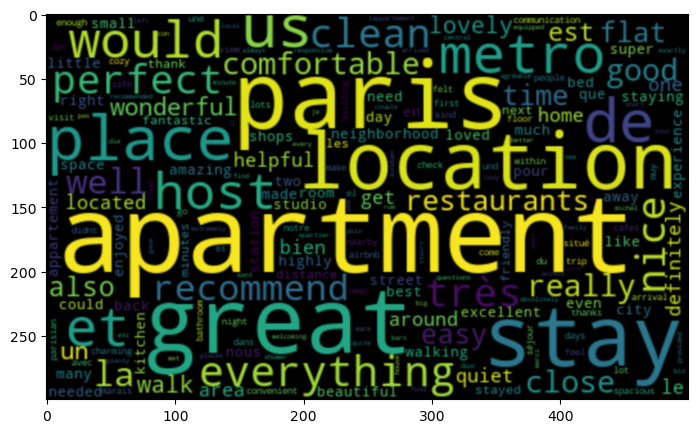

In [82]:
words_freq_dict = dict(zip(words_freq['words'], words_freq['counts']))

wordcloud = WordCloud(width=500, height=300)
wordcloud.generate_from_frequencies(frequencies=words_freq_dict)
plt.figure( figsize=(10,5) )
plt.imshow(wordcloud, interpolation="bicubic")
plt.show()

##### 4.5. Importing Calendar:

In [83]:
# Loading Dataset: 
df5 = pd.read_csv(r'C:\Users\paric\BoeingDataChallenge\calendar.csv')
df5.head()

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,5396,2023-03-14,f,$123.00,$123.00,1.0,1125.0
1,5396,2023-03-15,f,$123.00,$123.00,1.0,1125.0
2,5396,2023-03-16,f,$124.00,$124.00,1.0,1125.0
3,5396,2023-03-17,f,$124.00,$124.00,1.0,1125.0
4,5396,2023-03-18,f,$124.00,$124.00,1.0,1125.0


In [84]:
# Look at the Dataset Shape:
df5.shape

(20703571, 7)

In [85]:
# Removing ',' & '$' and converting to numeric:
df5['price'] = pd.to_numeric(df5['price'].str.replace(',', '').str.replace('$', ''))
df5['adjusted_price'] = pd.to_numeric(df5['adjusted_price'].str.replace(',', '').str.replace('$', ''))

In [86]:
# Convert boolean value to numeric:
df5['available'] = pd.to_numeric(df5['available'].replace({'t': 1, 'f': 0}))

In [87]:
# Convert to the a date object:
df5['date'] =  pd.to_datetime(df5['date']).astype('datetime64[ns]').dt.date

In [88]:
# Split date column and add year,month,day and day of week to new column:
df5["date_year"]=df5["date"].apply(lambda time:time.year)
df5["date_month"]=df5["date"].apply(lambda time:time.month)
df5["date_day"]=df5["date"].apply(lambda time:time.day)
df5['date'] = pd.to_datetime(df5['date'])
df5.head()

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights,date_year,date_month,date_day
0,5396,2023-03-14,0,123.0,123.0,1.0,1125.0,2023,3,14
1,5396,2023-03-15,0,123.0,123.0,1.0,1125.0,2023,3,15
2,5396,2023-03-16,0,124.0,124.0,1.0,1125.0,2023,3,16
3,5396,2023-03-17,0,124.0,124.0,1.0,1125.0,2023,3,17
4,5396,2023-03-18,0,124.0,124.0,1.0,1125.0,2023,3,18


In [89]:
# Extract 10% sample of dataset:
df5_sample=df5.sample(frac=0.1)

In [90]:
# Look at the Shape:
df5_sample.shape

(2070357, 10)

In [91]:
# Merge Two Dataset:
df_calendar = pd.merge(df5_sample, df_Imputed[['listing_id','accommodates']], on = 'listing_id', how = "left")
df_calendar.head()

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights,date_year,date_month,date_day,accommodates
0,2464417,2024-03-04,0,290.0,290.0,1.0,1125.0,2024,3,4,4.0
1,2464417,2024-03-04,0,290.0,290.0,1.0,1125.0,2024,3,4,4.0
2,2464417,2024-03-04,0,290.0,290.0,1.0,1125.0,2024,3,4,4.0
3,2464417,2024-03-04,0,290.0,290.0,1.0,1125.0,2024,3,4,4.0
4,2464417,2024-03-04,0,290.0,290.0,1.0,1125.0,2024,3,4,4.0


In [92]:
# Look at the Shape:
df_calendar.shape

(51810535, 11)

In [93]:
# Look at the Null values:
df_calendar.isnull().sum()

listing_id             0
date                   0
available              0
price                651
adjusted_price       651
minimum_nights       500
maximum_nights       500
date_year              0
date_month             0
date_day               0
accommodates      405284
dtype: int64

In [94]:
# Imputing missing value
missingvalue_columns = ['price','adjusted_price','minimum_nights','maximum_nights','accommodates']
for col in missingvalue_columns:
    df_calendar.loc[:, col] = df_calendar.loc[:, col].fillna(df_calendar.loc[:, col].median())

In [95]:
# Look at the number of available listing by date:
df_available = df_calendar[df_calendar.available == 1].groupby('date').size().to_frame(name= 'available').reset_index()
df_available.head()

,date,available
0,2023-03-13,1256
1,2023-03-14,13047
2,2023-03-15,17342
3,2023-03-16,18411
4,2023-03-17,21951


In [96]:
# Look at the number of Available Listing by Date:
fig = px.line(df_available, x='date', y='available', title='Number of Available Listing by Date')
fig.update_layout(xaxis_title='Date', yaxis_title='Number of Available Listings', showlegend=True)
fig.show()

In [97]:
# Look at the Average Price for 2 Available Accommodates by Date:
df_average_price = df_calendar[(df_calendar.available == 1) & (df_calendar.accommodates == 2)].groupby(['date']).mean().astype(np.int64).reset_index()
df_average_price['weekday'] = df_average_price['date'].dt.day_name()
df_average_price = df_average_price.set_index('date')
df_average_price.head()

,listing_id,available,price,adjusted_price,minimum_nights,maximum_nights,date_year,date_month,date_day,accommodates,weekday
date,,,,,,,,,,,
2023-03-13,87662984536847728,1,73,72,2,962,2023,3,13,2,Monday
2023-03-14,58353440128573560,1,142,140,32,736,2023,3,14,2,Tuesday
2023-03-15,43289340991615024,1,156,156,38,632,2023,3,15,2,Wednesday
2023-03-16,67052034566579224,1,151,150,50,692,2023,3,16,2,Thursday
2023-03-17,37802859164683528,1,247,246,40,516,2023,3,17,2,Friday


In [98]:
# Look at the number of Available Listing by Date:
fig = px.line(df_average_price, y='price', title='Average Price for 2 Available Persons by Date')
fig.update_layout(xaxis_title='Date', yaxis_title='Average Price for 2 Available Persons by Date', showlegend=True)
fig.show()

#### 5. Price:

In [99]:
# Look at the Correlation Between Price and other Columns:
df_Imputed.corr()["price"].sort_values(ascending=False)

price                                           1.000000
accommodates                                    0.219739
beds                                            0.114186
bedrooms                                        0.110273
availability_365                                0.099598
availability_60                                 0.073320
availability_90                                 0.071898
bathrooms                                       0.068497
calculated_host_listings_count_entire_homes     0.066166
calculated_host_listings_count                  0.065915
availability_30                                 0.055382
review_scores_location                          0.051258
host_listings_count                             0.041530
host_is_superhost                               0.031912
maximum_nights                                  0.031644
review_scores_cleanliness                       0.030049
host_id                                         0.028727
host_total_listings_count      

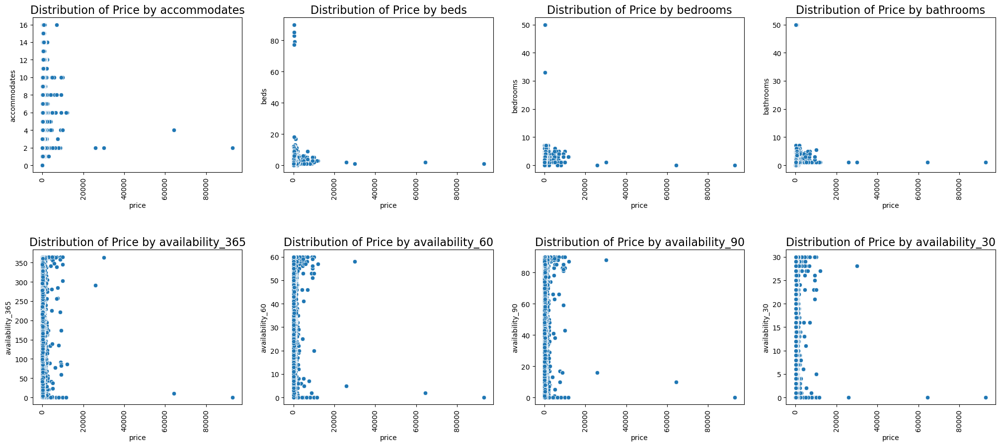

In [100]:
# Bivariate Visualization of Price Variable with highest correlation Columns:
cols=['accommodates','beds','bedrooms','bathrooms','availability_365','availability_60','availability_90','availability_30']
plt.figure(figsize=(25,20))
for i,col in enumerate(cols):
    plt.subplot(2,4,i+1)
    sns.scatterplot(x=df_Imputed['price'], y=df_Imputed[col])
    plt.title(f'Distribution of Price by {col}',fontsize=16)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=0.5, top=0.5)
plt.show()

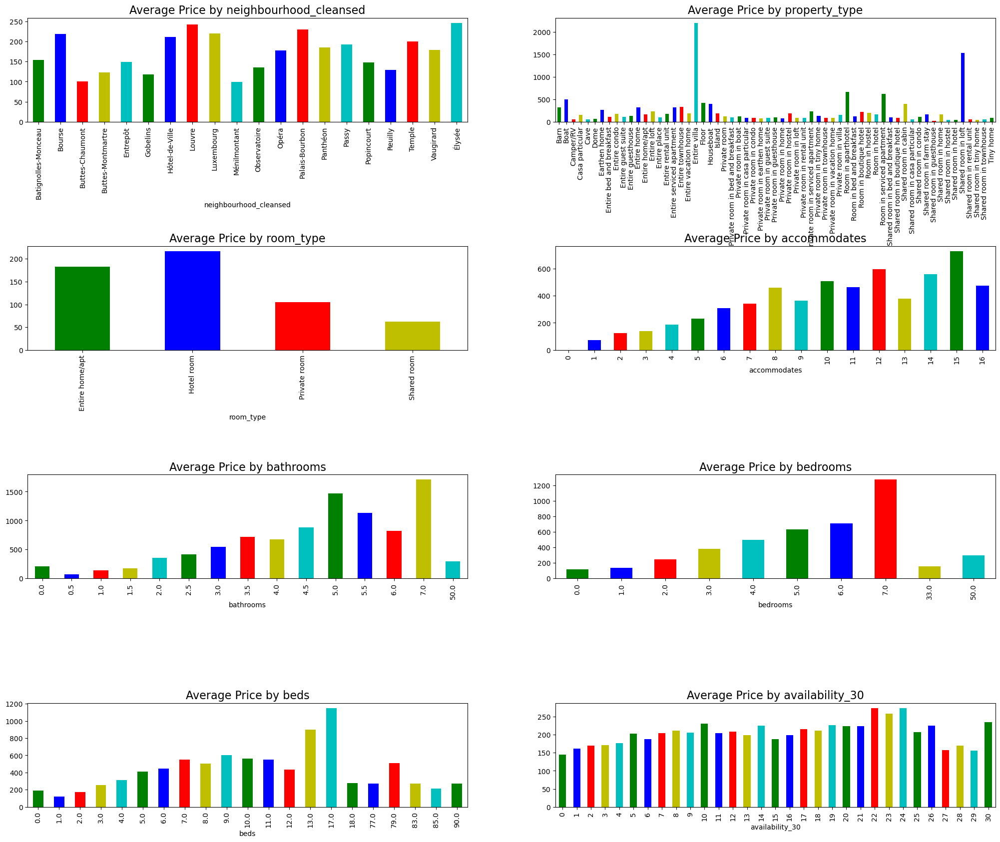

In [101]:
# Look at the Average Price by Columns:
cols=['neighbourhood_cleansed','property_type','room_type','accommodates','bathrooms','bedrooms','beds','availability_30']
plt.figure(figsize=(25,20))
for i,col in enumerate(cols):
    plt.subplot(4,2,i+1)
    df_Imputed.groupby(col)['price'].mean().plot(kind='bar', color=["g","b","r","y","c"])
    plt.title(f'Average Price by {col}',fontsize=16)
    plt.xticks(rotation=90)
plt.subplots_adjust(hspace=1.2, top=0.9)
plt.show()

#### 6. Applying Modele:
##### 6.1. Data Preparing:

(array([1.406675e+06, 1.480000e+02, 3.000000e+00, 2.000000e+00,
        0.000000e+00, 0.000000e+00, 1.000000e+01, 0.000000e+00,
        0.000000e+00, 7.000000e+00]),
 array([    0.,  9300., 18600., 27900., 37200., 46500., 55800., 65100.,
        74400., 83700., 93000.]),
 <BarContainer object of 10 artists>)

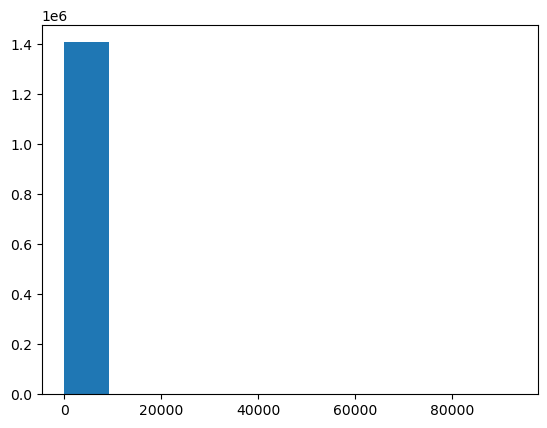

In [102]:
# Look at the distribution of Target Varibele:
plt.hist(df_Imputed['price'])

In [103]:
# perform logarithm transformation because target variable didn't follow normal distribution:
log_price = np.log(df_Imputed['price'])
log_price

C:\Users\paric\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning:

divide by zero encountered in log



0          4.820282
1          4.820282
2          4.820282
3          4.820282
4          4.820282
             ...   
1406840    4.110874
1406841    4.234107
1406842    4.787492
1406843    4.234107
1406844    4.290459
Name: price, Length: 1406845, dtype: float64

In [104]:
# Extract 50% sample of dataset Due to Memory Limitation:
df_sample=df_Imputed.sample(frac=0.5)
df_sample.shape

(703422, 66)

In [105]:
# Put Numeric Columns in variable
df_model = df_sample.select_dtypes(exclude=['object','datetime64[ns]'])
df_model.shape

(703422, 46)

In [106]:
# Put NonNumeric Columns in Variable:
df_categorical = df_sample.select_dtypes(include=['object'])
df_categorical.columns

Index(['comments', 'neighbourhood_cleansed', 'last_scraped', 'name',
       'description', 'neighborhood_overview', 'host_name', 'host_since',
       'host_location', 'host_about', 'host_response_time',
       'host_neighbourhood', 'host_verifications', 'neighbourhood',
       'property_type', 'room_type', 'amenities', 'calendar_last_scraped',
       'first_review', 'last_review'],
      dtype='object')

##### 6.1. Checking Variance Inflation Factor (VIF):

Applying the variance inflation factor (VIF) to check multicollinearity in independent variables. If VIF is greater than 10, there is multicollinearity and a need to remove the highest VIF column in the dataset and check again.

In [107]:
# Applying Variance Inflation Factor (VIF) on dataset:
X = df_model.drop(['price','geometry'],axis=1)
X['intercept'] = 1
Y = df_model['price']

vif = pd.DataFrame({'variables':X.columns,'VIF':[variance_inflation_factor(X.values, i) for i in range(len(X.columns))]})
vif.sort_values(by='VIF',ascending=False)

C:\Users\paric\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning:

divide by zero encountered in double_scalars



,variables,VIF
22,maximum_nights_avg_ntm,9.527718e+08
19,minimum_maximum_nights,4.633586e+08
20,maximum_maximum_nights,2.491561e+08
43,reviews_per_month,5.099317e+00
29,number_of_reviews_ltm,2.292859e+00
30,number_of_reviews_l30d,2.207709e+00
0,listing_id,1.321331e+00
26,availability_90,1.136564e+00
25,availability_60,1.128937e+00
24,availability_30,1.101082e+00


In [108]:
# Applying Variance Inflation Factor (VIF) on dataset after removing maximum_maximum_nights column :
X = df_model.drop(['price','geometry','maximum_maximum_nights'],axis=1)
X['intercept'] = 1
Y = df_model['price']

vif = pd.DataFrame({'variables':X.columns,'VIF':[variance_inflation_factor(X.values, i) for i in range(len(X.columns))]})
vif.sort_values(by='VIF',ascending=False)

C:\Users\paric\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning:

divide by zero encountered in double_scalars



,variables,VIF
42,reviews_per_month,5.106055e+00
21,maximum_nights_avg_ntm,4.370522e+00
19,minimum_maximum_nights,4.370389e+00
28,number_of_reviews_ltm,2.291415e+00
29,number_of_reviews_l30d,2.208079e+00
0,listing_id,1.321232e+00
25,availability_90,1.136749e+00
24,availability_60,1.129121e+00
23,availability_30,1.101327e+00
17,minimum_minimum_nights,1.090573e+00


##### 6.2. Convert Categorical Columns to Numeric by Dummies:

In [109]:
# Remove Useless Columns:
df_categorical=df_categorical.drop(['comments','last_scraped','name','description','neighborhood_overview','host_name','host_since',
                                    'host_location','host_about','host_neighbourhood','neighbourhood','amenities','calendar_last_scraped',
                                    'first_review','last_review'],axis=1)

In [110]:
# Applying Dummies:
dummies = pd.get_dummies(df_categorical, drop_first=True)
dummies.head()

,neighbourhood_cleansed_Bourse,neighbourhood_cleansed_Buttes-Chaumont,neighbourhood_cleansed_Buttes-Montmartre,neighbourhood_cleansed_Entrepôt,neighbourhood_cleansed_Gobelins,neighbourhood_cleansed_Hôtel-de-Ville,neighbourhood_cleansed_Louvre,neighbourhood_cleansed_Luxembourg,neighbourhood_cleansed_Ménilmontant,neighbourhood_cleansed_Observatoire,...,property_type_Shared room in hostel,property_type_Shared room in hotel,property_type_Shared room in loft,property_type_Shared room in rental unit,property_type_Shared room in tiny home,property_type_Shared room in townhouse,property_type_Tiny home,room_type_Hotel room,room_type_Private room,room_type_Shared room
966005,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
1048828,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1064919,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
451622,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
492692,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


In [111]:
# Concat Dummies Variables with Numeric Dataset:
df_models = pd.concat([df_model, dummies], axis=1)
df_models.head()

,listing_id,reviewer_id,geometry,host_id,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_identity_verified,...,property_type_Shared room in hostel,property_type_Shared room in hotel,property_type_Shared room in loft,property_type_Shared room in rental unit,property_type_Shared room in tiny home,property_type_Shared room in townhouse,property_type_Tiny home,room_type_Hotel room,room_type_Private room,room_type_Shared room
966005,32988830,21122981,"MULTIPOLYGON (((2.36469 48.88437, 2.36485 48.8...",39602261,100.0,100.0,0.0,2.0,2.0,1.0,...,0,0,0,0,0,0,0,0,1,0
1048828,37891006,16235945,"MULTIPOLYGON (((2.37491 48.83801, 2.37698 48.8...",218204882,100.0,98.0,0.0,1.0,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
1064919,39068925,21001860,"MULTIPOLYGON (((2.34459 48.85405, 2.34428 48.8...",222375907,100.0,100.0,0.0,56.0,75.0,1.0,...,0,0,0,0,0,0,0,0,0,0
451622,11298690,60436666,"MULTIPOLYGON (((2.27427 48.87837, 2.27749 48.8...",43848844,100.0,98.0,1.0,1.0,1.0,1.0,...,0,0,0,0,0,0,0,0,0,0
492692,12747571,138168815,"MULTIPOLYGON (((2.38943 48.90122, 2.39014 48.9...",36922531,100.0,98.0,0.0,1.0,2.0,1.0,...,0,0,0,0,0,0,0,0,1,0


##### 6.3. Scaling Dataset by ZScore:

In [112]:
# Scaling Median Imputed DataSet by Z_Score:

# Drop Useless Columns:
df_x = df_models.drop(['listing_id','reviewer_id','geometry','host_id','latitude','longitude','price','maximum_maximum_nights'], axis=1)

df_y = df_models['price']

# Scaling dataset by create a Standard Scaler Object:
scaler = StandardScaler()

# Fit and Transform the Data:
df_models_ZScaled = pd.DataFrame(scaler.fit_transform(df_x), columns=df_x.columns)
df_models_ZScaled.shape

(703422, 129)

In [113]:
# Spilit dataset:
x_train, x_test, y_train, y_test = train_test_split(df_x, df_y, test_size=0.3, random_state=0)
print("The number of observations in training set is {}".format(x_train.shape[0]))
print("The number of observations in test set is {}".format(x_test.shape[0]))

The number of observations in training set is 492395
The number of observations in test set is 211027


##### 6.4. Applying Supervized Learning Models:

###### 6.4.1. Linear Regression Model:

In [114]:
# Applying Linear Regression:
lr = LinearRegression()

# Fit the model:
lr.fit(x_train,y_train)

# Predict the model:
lr_y_preds = lr.predict(x_test)

In [115]:
# Evaluation metrics:
lr_mse = mean_squared_error(y_test, lr_y_preds)
lr_rmse = np.sqrt(mean_squared_error(y_test, lr_y_preds))
lr_mae = mean_absolute_error(y_test, lr_y_preds)

In [116]:
# Evaluation Performance Model:
lr_r2 = r2_score(y_test, lr_y_preds)

# Adjusted R2:
n = len(y_test)
# Number of predictors
p = x_test.shape[1]  
lr_adjusted_r2 = 1 - (1 - lr_r2) * (n - 1) / (n - p - 1)

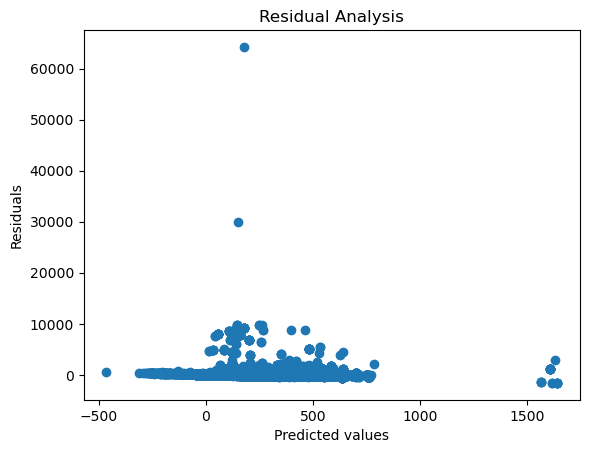

In [117]:
# Residuals Analysis:
residuals = y_test - lr_y_preds
plt.scatter(lr_y_preds, residuals)
plt.xlabel("Predicted values")
plt.ylabel("Residuals")
plt.title("Residual Analysis")
plt.show()

##### 6.4.2. Random Forest Regressor Model:

In [118]:
# Applying Random Forest:
rf = RandomForestRegressor()

# Fit the model on the training data:
rf.fit(x_train, y_train)

# Make predictions on the test data:
rf_y_preds = rf.predict(x_test)

In [119]:
# Evaluating Metrics:
rf_mse = mean_squared_error(y_test, rf_y_preds)
rf_rmse = np.sqrt(mean_squared_error(y_test, rf_y_preds))
rf_mae = mean_absolute_error(y_test, rf_y_preds)

In [120]:
# Evaluation Performance Model:
rf_r2 = r2_score(y_test, rf_y_preds)

# Adjusted R2:
n = len(y_test)
# Number of predictors
p = x_test.shape[1]  
rf_adjusted_r2 = 1 - (1 - rf_r2) * (n - 1) / (n - p - 1)

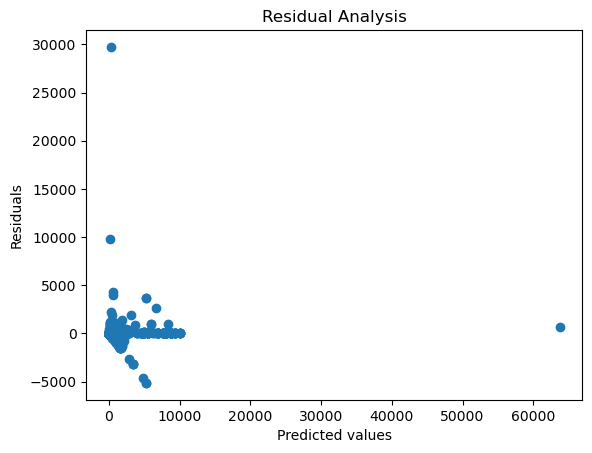

In [121]:
# Residual analysis
residuals = y_test - rf_y_preds
plt.scatter(rf_y_preds, residuals)
plt.xlabel("Predicted values")
plt.ylabel("Residuals")
plt.title("Residual Analysis")
plt.show()

###### 6.4.3. Comparing Models:

In [122]:
# Comparing Models Results:
comparing_primary_models = pd.DataFrame({'models':['Linear Regression', 'Random Forest Regressor'], 
                                       'Mean Squared Error':[lr_mse,rf_mse],
                                       'Root Mean Squared error':[lr_rmse, rf_rmse],
                                       'Mean Absolute Error':[lr_mae,rf_mae],                                       
                                       'R2':[lr_r2, rf_r2],
                                       'Adjusted_R2':[lr_adjusted_r2, rf_adjusted_r2]})
comparing_primary_models

,models,Mean Squared Error,Root Mean Squared error,Mean Absolute Error,R2,Adjusted_R2
0,Linear Regression,70051.319163,264.672097,61.551798,0.122334,0.121797
1,Random Forest Regressor,5998.425551,77.449503,2.087840,0.924846,0.924800


###### 6.4.4. Optimizing Models by Hyperparameter Optimization:
- RandomizedSearchCV 
- GridSearchCV

###### 6.4.4.1. Linear Regression Optimization:

In [123]:
# Define the hyperparameters to tune:
lr_param_grid = {
    'fit_intercept': [True, False],
    'normalize': [True, False],

}

In [124]:
# Create an instance of the linear regression model
lr = LinearRegression()

# Create an instance of GridSearchCV
lr_grid_search = GridSearchCV(lr, lr_param_grid, cv=5)

# Fit the GridSearchCV instance to training data
lr_grid_search.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=LinearRegression(),
             param_grid={'fit_intercept': [True, False],
                         'normalize': [True, False]})

In [125]:
# Get the best hyperparameters
lr_best_params = lr_grid_search.best_params_
print("Best Hyperparameters:", lr_best_params)

# Get the best model
lr_best_model = lr_grid_search.best_estimator_

# Predict on the test set using the best model
lr_optimized_y_preds = lr_best_model.predict(x_test)

Best Hyperparameters: {'fit_intercept': True, 'normalize': False}


In [126]:
# Evaluate the model
lr_optimized_mse = mean_squared_error(y_test, lr_optimized_y_preds)
lr_optimized_rmse = np.sqrt(mean_squared_error(y_test, lr_optimized_y_preds))
lr_optimized_mae = mean_absolute_error(y_test, lr_optimized_y_preds)

In [127]:
# Evaluation Performance Model:
lr_optimized_r2 = r2_score(y_test, lr_optimized_y_preds)

# Adjusted R2:
n = len(y_test)
# Number of predictors
p = x_test.shape[1]  
lr_optimized_adjusted_r2 = 1 - (1 - lr_optimized_r2) * (n - 1) / (n - p - 1)

###### 6.4.4.2.Random Forest Regressor Optimization:

In [136]:
# Define the hyperparameters to tune
rf_param_grid = {
    'n_estimators': [20, 30],
    'max_depth': [5, 10],
    'random_state': [1]
}

In [137]:
# Create an instance of the Random Forest regressor
rf = RandomForestRegressor()

# Create an instance of GridSearchCV
rf_grid_search = GridSearchCV(rf, rf_param_grid, cv=5)

# Fit the GridSearchCV instance to your training data
rf_grid_search.fit(x_train, y_train)

# Get the best hyperparameters
rf_best_params = rf_grid_search.best_params_
print("Best Hyperparameters:", rf_best_params)

# Get the best model
rf_best_model = rf_grid_search.best_estimator_

# Predict on the test set using the best model
rf_optimized_y_pred = rf_best_model.predict(x_test)

Best Hyperparameters: {'max_depth': 10, 'n_estimators': 20, 'random_state': 1}


In [139]:
# Evaluate the model
rf_optimized_mse = mean_squared_error(y_test, rf_optimized_y_pred)
rf_optimized_rmse = np.sqrt(mean_squared_error(y_test, rf_optimized_y_pred))
rf_optimized_mae = mean_absolute_error(y_test, rf_optimized_y_pred)

In [140]:
# Evaluation Performance Model:
rf_optimized_r2 = r2_score(y_test, rf_optimized_y_pred)

# Adjusted R2:
n = len(y_test)
# Number of predictors
p = x_test.shape[1]  
rf_optimized_adjusted_r2 = 1 - (1 - rf_optimized_r2) * (n - 1) / (n - p - 1)

###### 6.4.5. Comparing Optimized Models:

In [142]:
# Comparing Optimized Models Results:
comparing_opimized_models = pd.DataFrame({'models':['Optimized Linear Regression', 'Optimized Random Forest Regressor'], 
                                       'Mean Squared Error_Optimized Model':[lr_optimized_mse,rf_optimized_mse],
                                       'Root Mean Squared error_Optimized Model':[lr_optimized_rmse, rf_optimized_rmse],
                                       'Mean Absolute Error_Optimized Model':[lr_optimized_mae,rf_optimized_mae],                                       
                                       'R2_Optimized Model':[lr_optimized_r2, rf_optimized_r2],
                                       'Adjusted_R2_Optimized Model':[lr_optimized_adjusted_r2, rf_optimized_adjusted_r2]})
comparing_opimized_models

,models,Mean Squared Error_Optimized Model,Root Mean Squared error_Optimized Model,Mean Absolute Error_Optimized Model,R2_Optimized Model,Adjusted_R2_Optimized Model
0,Optimized Linear Regression,70051.319163,264.672097,61.551798,0.122334,0.121797
1,Optimized Random Forest Regressor,18867.100432,137.357564,44.995513,0.763616,0.763471


In [144]:
# Comparing Results:
# Compare all supervised learning methods:
Comparing_models_results = pd.DataFrame({'models_methods':['Linear Regression', 'Random Forest Regressor', 'Optimized Linear Regression', 'Optimized Random Forest Regressor'],
                                       'Mean Squared Error':[lr_mse,rf_mse,lr_optimized_mse,rf_optimized_mse],
                                       'Root Mean Squared error':[lr_rmse, rf_rmse,lr_optimized_rmse,rf_optimized_rmse],
                                       'Mean Absolute Error':[lr_mae,rf_mae,lr_optimized_mae,rf_optimized_mae],                                       
                                       'R2':[lr_r2, rf_r2, lr_optimized_r2,rf_optimized_r2],
                                       'Adjusted_R2':[lr_adjusted_r2, rf_adjusted_r2,lr_optimized_adjusted_r2,rf_optimized_adjusted_r2]})
Comparing_models_results

,models_methods,Mean Squared Error,Root Mean Squared error,Mean Absolute Error,R2,Adjusted_R2
0,Linear Regression,70051.319163,264.672097,61.551798,0.122334,0.121797
1,Random Forest Regressor,5998.425551,77.449503,2.087840,0.924846,0.924800
2,Optimized Linear Regression,70051.319163,264.672097,61.551798,0.122334,0.121797
3,Optimized Random Forest Regressor,18867.100432,137.357564,44.995513,0.763616,0.763471


- Based on the results obtained, the random forest model demonstrated the lowest mean error, indicating its better performance in terms of prediction accuracy. Additionally, the random forest model exhibited the highest adjusted square, indicating a better fit to the data compared to another model. Hence, the random forest model developed as the preferable choice based on these evaluation metrics.